In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

# データ読み込み

In [3]:
import sys
sys.path.append('/root/userspace/final')
print(sys.path)

['/usr/lib/python36.zip', '/usr/lib/python3.6', '/usr/lib/python3.6/lib-dynload', '', '/usr/local/lib/python3.6/dist-packages', '/usr/lib/python3/dist-packages', '/usr/local/lib/python3.6/dist-packages/IPython/extensions', '/root/.ipython', '/root/userspace/final']


In [4]:
import math
import csv
import copy
from tqdm import tqdm
import gc
import pickle

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Flatten, Lambda
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Dense, Embedding, LSTM
from tensorflow.keras.layers import Reshape, Activation, concatenate, dot, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from functools import partial

from transformer import Transformer

np.load = partial(np.load, allow_pickle=True)  # monkey patch

SEED=9999


In [34]:
def add_bos_eos(y_train, y_test, tokenizer):
    detokenizer = dict(map(reversed, tokenizer.word_index.items()))
    all_data = np.hstack([y_train, y_test])
    print(all_data.shape)

    # bos_eos追加
    for i, id_list in enumerate(all_data):
        words = ['<s>'] + [detokenizer[idx] for idx in id_list] + ['</s>']
        all_data[i] = words

    # tokenizer 更新
    tokenizer.fit_on_texts(all_data)
    
    # id のリストに戻す
    print(y_train.shape)
    for i, words in enumerate(all_data):
        if i < y_train.shape[0]:
            y_train[i] = list(map(lambda x: tokenizer.word_index[x], words))
        else:
            y_test[i-y_train.shape[0]] = list(map(lambda x: tokenizer.word_index[x], words))

    del all_data
    gc.collect()
    
def load_data():
    def load_pickle(path):
        with open(path, 'rb') as handle:
          return pickle.load(handle)

    # 学習データ
    #x_train = np.load('/root/userspace/final/train_img.npz')['arr_0']
    y_train = np.load('/root/userspace/final/y_train.npy')
    tokenizer = load_pickle('/root/userspace/final/tokenizer.pickle')
    # テストデータ
    #x_test = np.load('/root/userspace/final/test_img.npz')['arr_0']
    y_test = np.load('/root/userspace/final/y_test.npy')
    #test_tokenizer = load_pickle('/content/drive/My Drive/Colab Notebooks/data/test_tokenizer.pickle')
    
    # bos_eos 追加
    add_bos_eos(y_train, y_test, tokenizer)

    print(y_test.shape, y_train.shape)
    # 長さを最長のリストにそろえる。短いものは0パディング
    y_train = pad_sequences(y_train, padding='post')
    y_test = pad_sequences(y_test, padding='post')

    #return (x_train, y_train, train_tokenizer, x_test, y_test, test_tokenizer)
    return (x_train, y_train, x_test, y_test, tokenizer)

x_train, y_train, x_test, y_test, tokenizer = load_data()

(4720,)
(4000,)
(720,) (4000,)


# モデル学習

## モデルの定義

In [38]:
# 色々定義
detokenizer = dict(map(reversed, tokenizer.word_index.items()))
vocab_size = len(tokenizer.word_index)
print("vocab_size: ",vocab_size)

vocab_size:  268


In [5]:
# グラフ定義
graph = tf.Graph()
with graph.as_default():
    transformer = Transformer(
        vocab_size=bo
    )

4000it [00:00, 19604.91it/s]

(4000, 266)


In [6]:
x_tra, x_val, y_tra, y_val = train_test_split(x_train, y_train_ohe, test_size=0.1, random_state=SEED, shuffle=True)

### CNN+sigmoid マルチラベル分類モデル

In [8]:
# 損失関数
def binary_loss(y_true, y_pred):
    print(y_true.shape)
    bce = K.binary_crossentropy(y_true, y_pred)
    print(bce.shape)
    return K.sum(bce, axis=-1)

# 評価関数
def total_acc(y_true, y_pred):
    pred = K.cast(K.greater_equal(y_pred, 0.5), "float")
    flag = K.cast(K.equal(y_true, pred), "float")
    return K.prod(flag, axis=-1)

def binary_acc(y_true, y_pred):
    pred = K.cast(K.greater_equal(y_pred, 0.5), 'float')
    flag = K.cast(K.equal(y_true, pred), 'float')
    return K.mean(flag, axis=-1)


model = Model(encoder_input, out)
model.compile(loss=binary_loss, optimizer=Adam(), metrics=[total_acc, binary_acc])
#model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=[total_acc, binary_acc])

(?, ?)
(?, 266)


In [9]:
def random_crop(img, crop_size):
    '''画像の一部をランダムにクロップする
    img: 画像 ndarray
    crop_size cropする width, height : array-like
    '''
    #l, t決定
    h, w = img.shape[0], img.shape[1]
    crop_h, crop_w = crop_size[1], crop_size[0]
    top = np.random.choice(list(range(0, h-crop_h)))
    left = np.random.choice(list(range(0, w-crop_w)))
    return img[top:top+crop_h, left:left+crop_w, :]
# from PIL import Image
# a = random_crop(np.asarray(Image.open('img1.jpg')), (224,224))
# print(a.shape)
# plt.imshow(a/255.0)

# 水増し用
def train_generator(x, y, batch_size):
    gen_params = {
        'rotation_range':20,
        'horizontal_flip':True,
        'vertical_flip': True,
        'height_shift_range':0.2,
        'width_shift_range':0.2,
        'shear_range': 5,
        'zoom_range':0.2,
        'channel_shift_range':5.,
        #'featurewise_center': True, #データセット全体で画素値平均を0にする
        'samplewise_center': True, #サンプルごとの画素値の平均を0にする
    }
    img_gen = ImageDataGenerator(**gen_params)
    for x_batch, y_batch in img_gen.flow(x,y,batch_size=batch_size):
        #print(x_batch.shape)
        cropped_imgs = np.zeros((x_batch.shape[0], 224, 224, 3))
        # random crop
        for i, x in enumerate(x_batch):
            cropped_imgs[i] = random_crop(x, (224, 224))
        #print(cropped_imgs.shape)
        yield cropped_imgs, y_batch

def val_generator(x, y, batch_size):
    img_gen = ImageDataGenerator() # 検証用には処理を加えない
    for x_batch, y_batch in img_gen.flow(x,y,batch_size=batch_size):
        cropped_imgs = np.zeros((x_batch.shape[0], 224, 224, 3))
        # random crop
        for i, x in enumerate(x_batch):
            cropped_imgs[i] = random_crop(x, (224, 224))
        yield cropped_imgs, y_batch
        #yield x_batch, y_batch

### モデル図

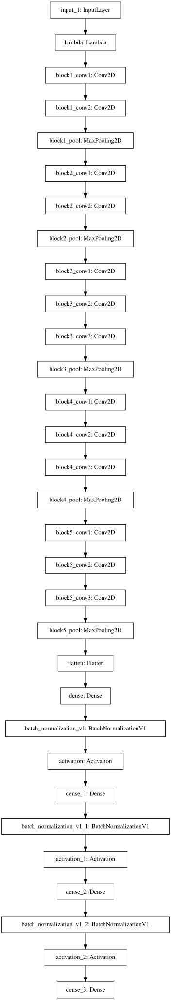

In [10]:
from IPython.display import SVG
from tensorflow.python.keras.utils.vis_utils import model_to_dot

SVG(model_to_dot(model).create(prog='dot', format='svg'))

# 学習

### train_target の内容　要検討

In [11]:
modelpath = '/root/userspace/final/models/transformer.h5'
callbacks = [
    EarlyStopping(monitor='val_loss', patience=50),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=30),
    ModelCheckpoint(filepath=modelpath, monitor='val_total_acc', save_best_only=True)
]
batch_size=64
epochs = 5000
model.fit_generator(train_generator(x_tra, y_tra, batch_size),
                    steps_per_epoch=len(x_train)//batch_size,
                    epochs=epochs,
                    validation_data=val_generator(x_val, y_val, batch_size),
                    validation_steps=len(x_val)//batch_size,
                    callbacks=callbacks,
                    verbose=2)
# model.fit(x_train, y_train_ohe,
#           batch_size=128, epochs=1000, verbose=1, validation_split=0.1, callbacks=callbacks)

Instructions for updating:
Use tf.cast instead.
Epoch 1/5000
6/6 [==============================] - 3s 580ms/step - loss: 65.4870 - total_acc: 0.0000e+00 - binary_acc: 0.9810
 - 105s - loss: 31.9929 - total_acc: 5.1020e-04 - binary_acc: 0.9636 - val_loss: 65.4870 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9810
Epoch 2/5000
6/6 [==============================] - 3s 448ms/step - loss: 24.3620 - total_acc: 0.0000e+00 - binary_acc: 0.9803
 - 59s - loss: 20.2119 - total_acc: 5.1020e-04 - binary_acc: 0.9815 - val_loss: 24.3620 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9803
Epoch 3/5000
6/6 [==============================] - 3s 433ms/step - loss: 25.6195 - total_acc: 0.0000e+00 - binary_acc: 0.9791
 - 61s - loss: 19.8825 - total_acc: 0.0010 - binary_acc: 0.9815 - val_loss: 25.6195 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9791
Epoch 4/5000
6/6 [==============================] - 3s 451ms/step - loss: 26.4693 - total_acc: 0.0000e+00 - binary_acc: 0.9756
 - 61s - loss: 19.5398 -

# 精度確認

In [10]:
model = load_model('/root/userspace/final/models/transformer.h5',
                   custom_objects={'binary_loss': binary_loss, 'total_acc': total_acc, 'binary_acc': binary_acc})

(?, ?)
(?, 266)
Instructions for updating:
Use tf.cast instead.


## test データ IoU 確認

In [23]:
# train
from PIL import Image
def predict(x, model):
    resize_x = np.zeros((x.shape[0], 224,224,3))
    for i, img in enumerate(x):
        print(img.shape)
        img = Image.fromarray(img).resize((224,224))
        resize_x[i] = np.asarray(img)

    print(resize_x.shape)
    preds = model.predict(resize_x)
    return preds

def calc_iou(x, y, model):
    preds = model.predict(x)
    #preds = predict(x, model)
    iou_list = []
    # [TODO] : 予測させる単語の確率
    th = 0.05
    for i, (pred, true_list) in tqdm(enumerate(zip(preds, x))):
        indexes = np.where(pred > th)[0]
        print(indexes)
        pred_words = [detokenizer[idx+1] for idx in indexes]
        true_words = [detokenizer[idx] for idx in y[i] if idx != 0]
        # for idx in indexes:
        #     pred_words.append(tokenizer.index_word[idx+1])
        #     #true_words.append(test_tokenizer.index_word[])
        print(f'---------------- img{i} ----------------')
        print('pred words: ', pred_words)
        print('true_words: ', true_words)
        
        num_i = len(set(pred_words) & set(true_words))
        num_u = len(set(pred_words) | set(true_words))
        iou_list.append(num_i / num_u)

        #plt.imshow(x[i]/255.)
        #plt.show()
    print('Total IoU: {}'.format(np.mean(iou_list)))
#calc_iou(x_train, y_train, model)

In [24]:
calc_iou(x_test, y_test, model)

204it [00:00, 1060.42it/s]

[  1   3  10  12  15  16  27  32  43  82 108]
---------------- img0 ----------------
pred words:  ['塩', 'ニンニク', '黒胡椒', '卵', 'サラダ油', '片栗粉', '鶏肉', '小麦粉', '豚肉', 'タコ', '薄力粉']
true_words:  ['鶏肉', '卵', '黒胡椒', '片栗粉']
[  0   4   5  19 135]
---------------- img1 ----------------
pred words:  ['醤油', 'ゴマ油', 'みりん', 'バター', 'かぼちゃ']
true_words:  ['みりん', '醤油', 'ゴマ油', 'かぼちゃ']
[  2   3   9  17  23  45  47  51 118 124]
---------------- img2 ----------------
pred words:  ['砂糖', 'ニンニク', 'オリーブオイル', '酢', 'キュウリ', 'イカ', '鷹の爪', 'ピーマン', 'マジックソルト', 'ガーリックパウダー']
true_words:  ['ガーリックパウダー', 'マジックソルト', '鷹の爪', 'オリーブオイル', 'イカ', 'ピーマン']
[  1   4  23  27  28  35  73 103]
---------------- img3 ----------------
pred words:  ['塩', 'ゴマ油', 'キュウリ', '鶏肉', 'ゴマ', '大葉', 'ハム', '梅干し']
true_words:  ['生姜', 'ニラ', '醤油', 'ニンニク', '豚肉', '砂糖', 'オイスターソース', 'ゴマ油']
[ 1  6 21 24 40]
---------------- img4 ----------------
pred words:  ['塩', '生姜', 'レモン', 'こしょう', 'オリーブ油']
true_words:  ['レモン', 'オリーブ油', '生姜', 'こしょう', '塩', '唐辛子']
[  1  12  13  18  31

370it [00:00, 926.59it/s] 

[ 12  13  33  69  73 129 209]
---------------- img204 ----------------
pred words:  ['卵', 'マヨネーズ', 'トマト', '餃子の皮', 'ハム', 'ピザ生地', '明太子']
true_words:  ['トマト', '明太子', 'マヨネーズ', 'ハム', 'ピザ生地']
[ 0  3 14 43 92]
---------------- img205 ----------------
pred words:  ['醤油', 'ニンニク', 'だしの素', '豚肉', '山椒']
true_words:  ['鯖', '赤ワイン', 'バルサミコ酢']
[  1   2   6   8   9  10  12  15  16  30  32  46 105 180]
---------------- img206 ----------------
pred words:  ['塩', '砂糖', '生姜', '塩コショウ', 'オリーブオイル', '黒胡椒', '卵', 'サラダ油', '片栗粉', '麺つゆ', '小麦粉', '七味唐辛子', 'エリンギ', '鴨']
true_words:  ['七味唐辛子', '黒胡椒', '麺つゆ', '鴨']
[  0   1   3  10  11  12  19  20  39  57  68 179]
---------------- img207 ----------------
pred words:  ['醤油', '塩', 'ニンニク', '黒胡椒', '玉ねぎ', '卵', 'バター', '日本酒', '鰹節', 'ご飯', '白子', 'たけのこ']
true_words:  ['黒胡椒', '醤油', 'ご飯', '日本酒', '塩', '鰹節', 'たけのこ', 'バター']
[  1  12  21  25  26 249]
---------------- img208 ----------------
pred words:  ['塩', '卵', 'レモン', '大根', 'にんじん', 'サワークリーム']
true_words:  ['サワークリーム', '塩', '卵', 'レモン']
[ 

456it [00:00, 896.95it/s]


[  1   3   8  13  19  32  54  69 105 176]
---------------- img371 ----------------
pred words:  ['塩', 'ニンニク', '塩コショウ', 'マヨネーズ', 'バター', '小麦粉', 'キャベツ', '餃子の皮', 'エリンギ', 'コーン']
true_words:  ['生姜', '醤油', 'だしの素', '砂糖']
[  1  10  11  20  21  23  33  42  78  80  97 102 121 241]
---------------- img372 ----------------
pred words:  ['塩', '黒胡椒', '玉ねぎ', '日本酒', 'レモン', 'キュウリ', 'トマト', 'パセリ', 'パスタ', '鮭', 'バジル', '枝豆', '菜種油', 'とうもろこし']
true_words:  ['トマト', 'パスタ', '菜種油', 'レモン', 'とうもろこし', '枝豆', 'バジル', '塩']
[  1  10  11  12  16  20  21  84 150 164]
---------------- img373 ----------------
pred words:  ['塩', '黒胡椒', '玉ねぎ', '卵', '片栗粉', '日本酒', 'レモン', 'レタス', '豆乳', 'えんどう豆']
true_words:  ['黒胡椒', '豆乳', '日本酒', '塩', '片栗粉', '玉ねぎ']
[  0   1   6  19  35  41  42  81  96 110 192]
---------------- img374 ----------------
pred words:  ['醤油', '塩', '生姜', 'バター', '大葉', '刺身', 'パセリ', '茗荷', 'ムツ', '塩昆布', 'せり']
true_words:  ['大葉', '刺身', '生姜', '醤油', 'ムツ', '茗荷']
[  0   1   6   7   9  35  41  96 186]
---------------- img375 --------

720it [00:00, 927.60it/s]

true_words:  ['みりん', 'ねぎ', 'カレイ', '醤油', '砂糖', '片栗粉', 'えのき', 'にんじん', 'だしの素', 'サラダ油']
[  1   3   4   7   8   9  47 105 131 244]
---------------- img539 ----------------
pred words:  ['塩', 'ニンニク', 'ゴマ油', 'ねぎ', '塩コショウ', 'オリーブオイル', '鷹の爪', 'エリンギ', '焼肉のたれ', 'メンマ']
true_words:  ['メンマ', '鷹の爪', 'ゴマ油', '焼肉のたれ']
[ 0  2  4  5 14 16 17 20 25 94]
---------------- img540 ----------------
pred words:  ['醤油', '砂糖', 'ゴマ油', 'みりん', 'だしの素', '片栗粉', '酢', '日本酒', '大根', '料理酒']
true_words:  ['みりん', '醤油', 'だしの素', '砂糖']
[  1  31 193]
---------------- img541 ----------------
pred words:  ['塩', 'じゃがいも', '落花生']
true_words:  ['落花生', '塩']
[  5  12  26  30  39  45  80 157]
---------------- img542 ----------------
pred words:  ['みりん', '卵', 'にんじん', '麺つゆ', '鰹節', 'イカ', '鮭', 'セロリ']
true_words:  ['にんじん', '麺つゆ', '卵', '鰹節']
[ 0  2  6 17 23 79]
---------------- img543 ----------------
pred words:  ['醤油', '砂糖', '生姜', '酢', 'キュウリ', 'マグロ']
true_words:  ['キュウリ', '生姜', '醤油', '酢', '砂糖']
[  0   2   3   4   7  10  11  22  35  38  79 149]


img 0: ['醤油', '塩', '塩コショウ', 'バター', '大葉', '刺身', '白子', 'ホタテ', 'せり']


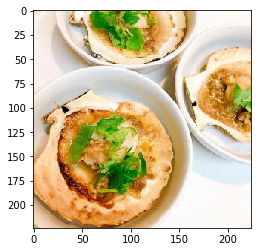

img 1: ['醤油', '塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '玉ねぎ', 'サラダ油', '片栗粉', '鶏肉', '揚げ油', '豚肉']


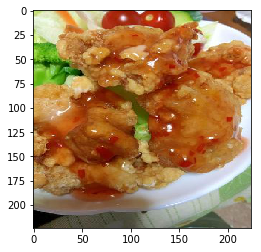

img 2: ['醤油', '塩', 'ゴマ油', 'みりん', '玉ねぎ', '卵', 'マヨネーズ', '日本酒', 'レモン', '豆腐', 'ホタテ', 'ツナ', 'だし醤油']


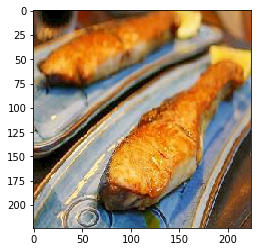

img 3: ['塩', 'みりん', 'オリーブオイル', '卵', 'だしの素', '大根', '厚揚げ', '柿']


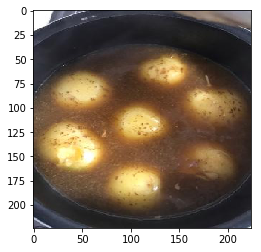

img 4: ['塩', '塩コショウ', 'だしの素', '片栗粉', '大根', 'ポン酢', '豆腐', '白菜', 'ツナ', '柚子']


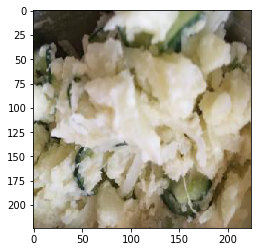

img 5: ['醤油', '塩', '生姜', 'オリーブオイル', '大葉', '刺身', '料理酒', 'ムツ', 'せり', '鯛']


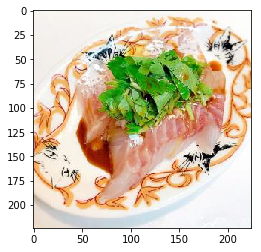

img 6: ['醤油', '砂糖', 'ニンニク', '生姜', '塩コショウ', '片栗粉', '鶏肉', '揚げ油']


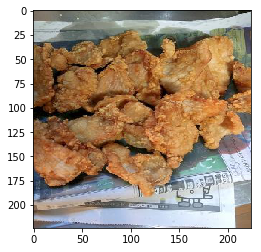

img 7: ['ニンニク', 'ねぎ', 'オリーブオイル', 'チーズ', 'バター', '日本酒', 'こしょう', 'ポン酢', 'しめじ', 'ウインナー', 'ガーリックソルト']


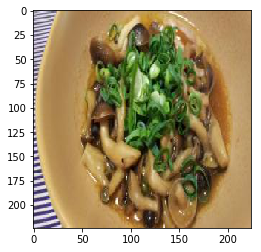

img 8: ['塩', '生姜', '塩コショウ', '卵', 'サラダ油', '片栗粉', 'キュウリ', '揚げ油', '小麦粉']


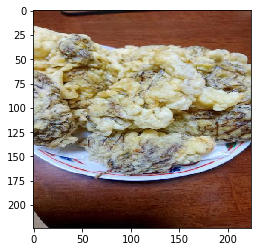

img 9: ['塩コショウ', 'ポン酢', '鰹節', 'ピーマン', 'えんどう豆', 'ホヤ']


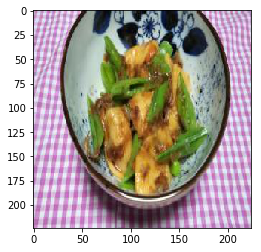

img 10: ['醤油', '砂糖', '生姜', '玉ねぎ', '卵', 'だしの素', 'サラダ油', '味噌', '大根', 'じゃがいも', 'イカ', '鶏ひき肉', 'ザーサイ']


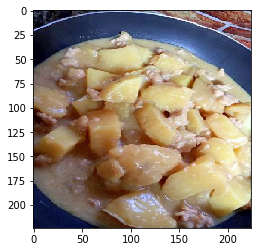

img 11: ['醤油', '塩', 'ねぎ', '卵', '片栗粉', '日本酒', '大根', 'ポン酢', '鰹節', '山椒', '長芋', '昆布']


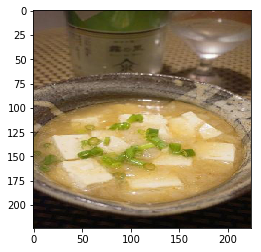

img 12: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒', 'バター', 'キュウリ', '鰹節', 'パセリ', '豚肉', 'ハム']


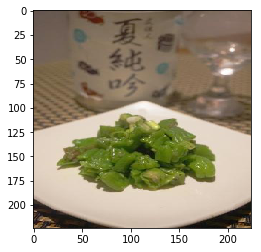

img 13: ['醤油', '塩', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'バター', 'じゃがいも', 'とろけるチーズ', '鰹節', '粉チーズ', 'マグロ', '山椒', '長芋', '青海苔', 'マッシュルーム', 'アンチョビ']


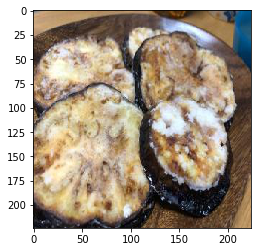

img 14: ['塩', 'みりん', 'ねぎ', 'だしの素', '酢', '大根', '昆布']


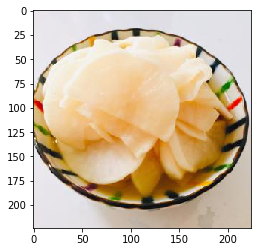

img 15: ['塩', '砂糖', 'みりん', 'オリーブオイル', '玉ねぎ', 'だしの素', 'キュウリ', 'トマト', '菜種油', 'パプリカ']


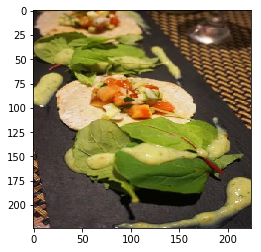

img 16: ['塩', '黒胡椒', '玉ねぎ', '卵', 'マヨネーズ', 'レモン']


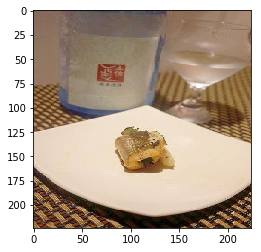

img 17: ['塩', '玉ねぎ', 'バター', '日本酒', 'にんじん', 'トマト', 'パセリ', 'パスタ', '菜種油', 'セロリ', 'つぶ貝']


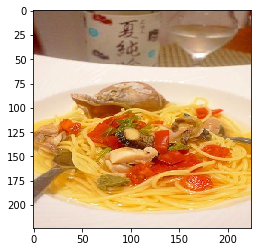

img 18: ['塩', 'みりん', '卵', 'トマト', '菜種油', '豆乳']


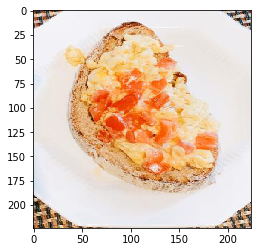

img 19: ['塩', '黒胡椒', '玉ねぎ', '卵', 'レモン', 'キュウリ', 'ご飯', '粒マスタード', '菜種油']


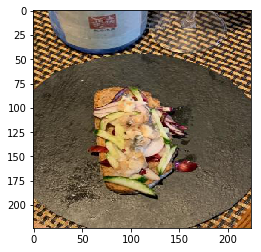

img 20: ['醤油', '生姜', 'ねぎ', '玉ねぎ', '大葉', '刺身', 'こんにゃく', 'カイワレ', 'ナンプラー']


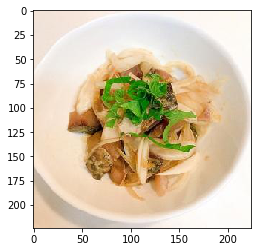

img 21: ['醤油', 'ねぎ', '塩コショウ', '玉ねぎ', '片栗粉', 'バター', '麺つゆ', '豆腐', 'とろけるチーズ', '山芋']


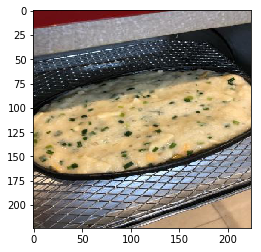

img 22: ['醤油', '塩', 'ニンニク', '生姜', 'オリーブオイル', '黒胡椒', 'チーズ', 'キュウリ', 'トマト', '鷹の爪']


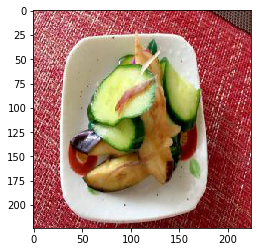

img 23: ['醤油', '塩', '生姜', 'オリーブオイル', 'バター', '刺身']


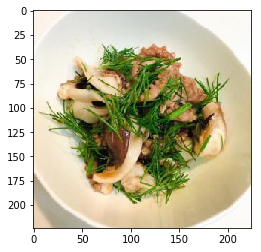

img 24: ['醤油', 'ニンニク', 'ゴマ油', 'ねぎ', '塩コショウ', '黒胡椒', '玉ねぎ', 'マヨネーズ', 'サラダ油', 'ゴマ', 'ポン酢', '鰹節', '豆板醤', 'ラー油', '味の素', '胸肉']


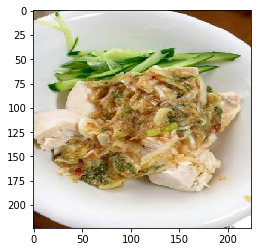

img 25: ['塩', '黒胡椒', '卵', '片栗粉', 'バター', '日本酒', '味噌', '大根', 'ご飯', 'はちみつ', '菜の花']


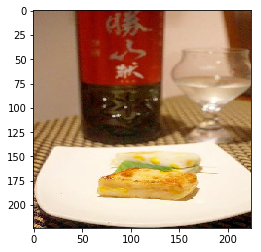

img 26: ['醤油', '塩', '卵', '片栗粉', '日本酒', '山椒', '昆布', 'えんどう豆']


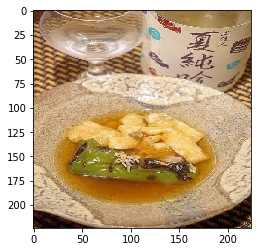

img 27: ['塩', '片栗粉', '日本酒', 'キュウリ', '大葉', 'パスタ', '菜種油', '薄口醤油', '梅', 'とうもろこし']


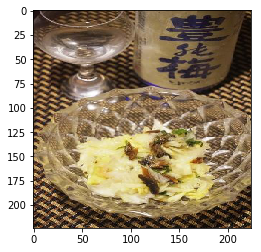

img 28: ['塩', 'ニンニク', 'ゴマ油', '生姜', 'キュウリ', '鶏肉', '麺つゆ', 'もやし']


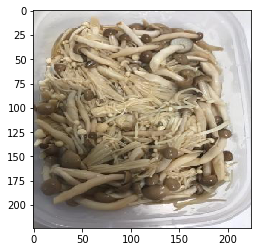

img 29: ['醤油', '塩', 'サラダ油', '片栗粉', 'バター', '日本酒', '大根', '鰹節', '青海苔', '里芋']


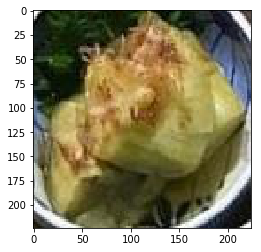

img 30: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '酢', 'バター', '小麦粉', 'パセリ', 'キャベツ', '白子', 'コーン']


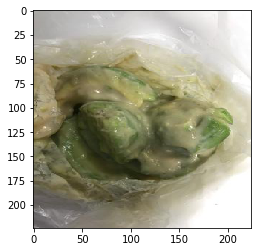

img 31: ['醤油', '砂糖', 'みりん', '生姜', 'ねぎ', '玉ねぎ', '味噌', '大根', '一味唐辛子']


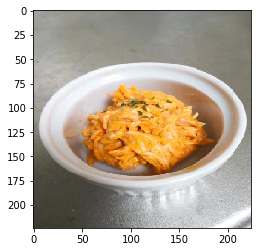

img 32: ['醤油', '塩', 'オリーブオイル', 'にんじん', '刺身', 'パセリ', '鮭']


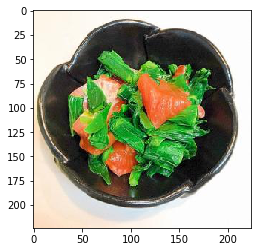

img 33: ['醤油', 'ねぎ', 'オリーブオイル', '玉ねぎ', '一味唐辛子', '厚揚げ']


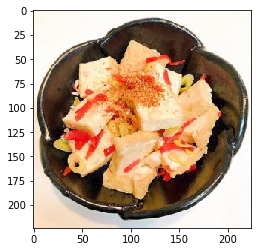

img 34: ['醤油', '塩', '砂糖', 'ねぎ', 'オリーブオイル', '酢', '味噌']


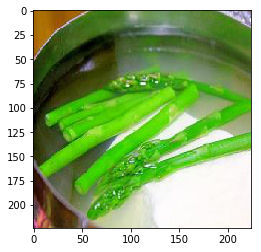

img 35: ['塩', 'ニンニク', '黒胡椒', '玉ねぎ', '卵', '片栗粉', '日本酒', 'レモン', 'レタス']


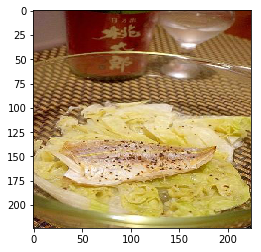

img 36: ['塩', 'ニンニク', '黒胡椒', '玉ねぎ', '大葉', 'パセリ', '白ワイン', 'パスタ', '菜種油', 'ジェノベーゼソース', 'つぶ貝']


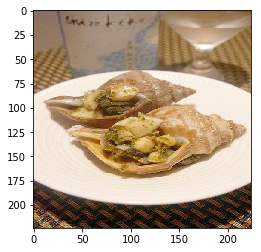

img 37: ['塩', 'ニンニク', 'ゴマ油', 'だしの素', 'こしょう', 'じゃがいも']


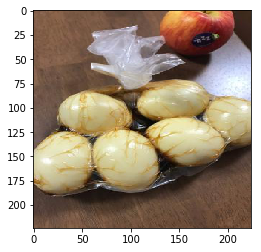

img 38: ['ニンニク', 'ねぎ', '塩コショウ', '卵', 'だしの素', 'サラダ油', '片栗粉', '鶏肉', '揚げ油', '小麦粉', 'パン粉']


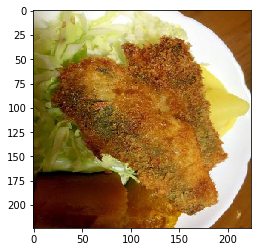

img 39: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒', '玉ねぎ', '卵', 'バター', 'キュウリ', 'パセリ', '鮭', 'コーン', 'たけのこ', 'サワークリーム']


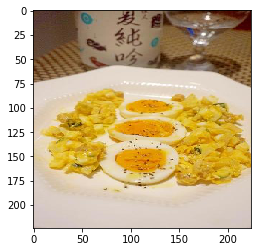

img 40: ['塩', 'ニンニク', '塩コショウ', '黒胡椒', '玉ねぎ', 'トマト', 'パセリ', '白ワイン', 'パスタ', '菜種油', 'えんどう豆']


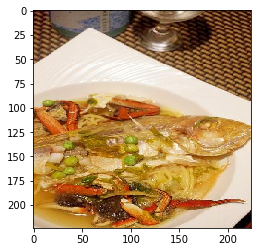

img 41: ['醤油', '塩', '黒胡椒', '玉ねぎ', 'バター', '日本酒', '大葉', 'パセリ', 'パスタ', '菜種油', 'たけのこ']


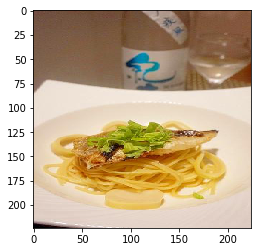

img 42: ['醤油', '砂糖', 'みりん', '生姜', '昆布']


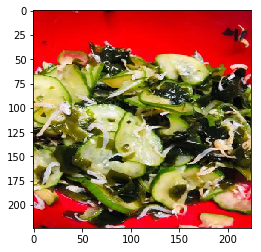

img 43: ['醤油', '塩', 'ねぎ', '卵', 'にんじん', '酒粕']


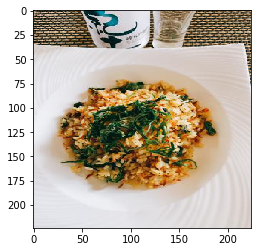

img 44: ['醤油', '塩', 'ゴマ油', '生姜', '酢', '日本酒', '味噌', '大根', 'こんにゃく', '秋刀魚']


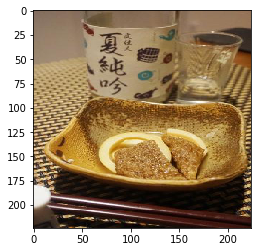

img 45: ['塩', 'ゴマ油', '黒胡椒', '玉ねぎ', '酢', '日本酒', 'レモン', 'キュウリ', 'にんじん', 'トマト', 'パスタ', '菜種油', '鰯', 'セロリ', 'ライム']


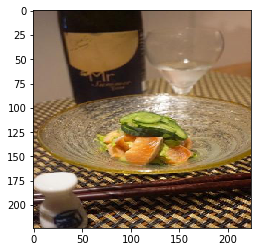

img 46: ['醤油', '生姜', '日本酒', '味噌', '大根', '竹輪', 'こんにゃく', 'カイワレ']


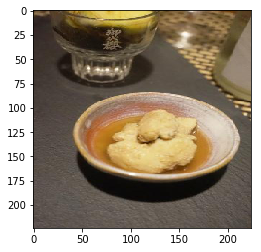

img 47: ['塩', '黒胡椒', '卵', 'だしの素', '日本酒', '大根', 'ご飯', '粉チーズ', '牛乳', 'こんにゃく', '鰯']


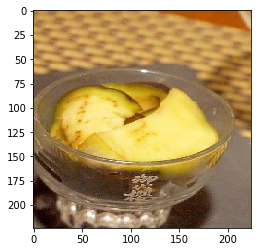

img 48: ['塩', '生姜', 'ねぎ', 'だしの素', '日本酒', '大根', '豆腐', '山椒']


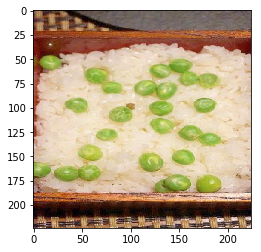

img 49: ['醤油', 'ねぎ', '塩コショウ', '片栗粉', '大根', '鰹節', 'ナス', '厚揚げ', '柚子こしょう', '鯖']


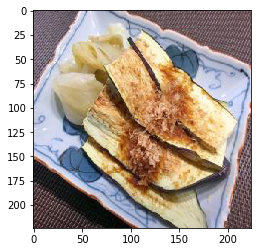

img 50: ['醤油', '砂糖', 'ゴマ油', 'だしの素', '麺つゆ', '昆布']


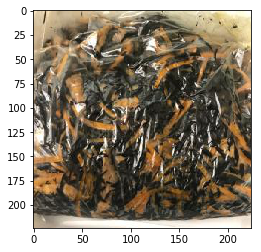

img 51: ['塩', 'ねぎ', '牡蠣', '梅干し', 'カイワレ']


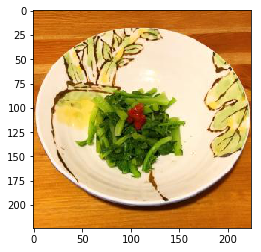

img 52: ['塩', 'ニンニク', '塩コショウ', '揚げ油', '小麦粉', 'とろけるチーズ', 'パン粉']


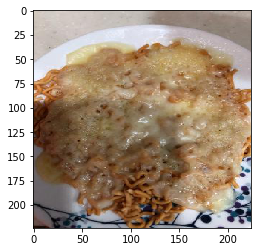

img 53: ['醤油', '塩', 'ゴマ油', 'だしの素', '白子', '梅干し', '本つゆ']


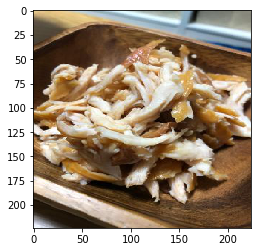

img 54: ['醤油', '塩', '砂糖', 'みりん', '生姜', 'ねぎ', '塩コショウ', 'レモン', '大根', '鶏肉', '麺つゆ', '七味唐辛子']


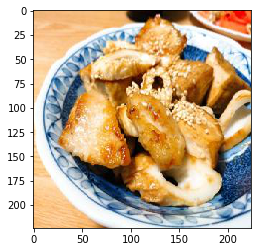

img 55: ['醤油', '塩', '砂糖', 'みりん', '生姜', 'だしの素', '酢', '日本酒', '味噌', '大根', '大葉', 'わさび', '茗荷']


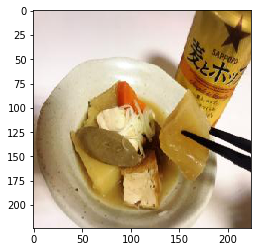

img 56: ['塩', 'ゴマ油', 'マヨネーズ', 'チーズ', 'ポン酢', '竹輪', '海苔', '長芋']


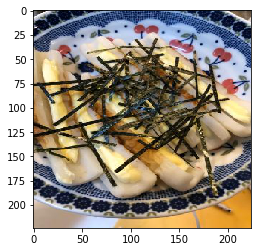

img 57: ['醤油', 'ゴマ油', '生姜', 'ねぎ', '卵', 'ゴマ', '麺つゆ', '小ねぎ']


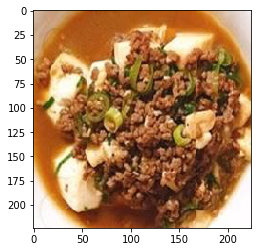

img 58: ['醤油', '塩', 'みりん', 'だしの素', '日本酒', 'こしょう', 'しめじ', 'えのき', '昆布']


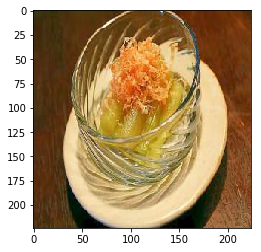

img 59: ['醤油', '塩', 'ニンニク', '黒胡椒', '片栗粉', 'こしょう', 'エビ', '白ワイン', 'ブロッコリー', '昆布', '菜種油', 'アラ', '豆乳', '菜の花']


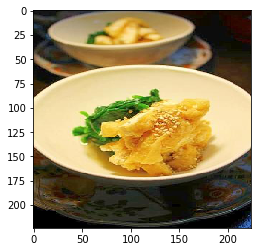

img 60: ['塩', '片栗粉', '日本酒', '山椒', 'えんどう豆', '鱧', 'かぶ']


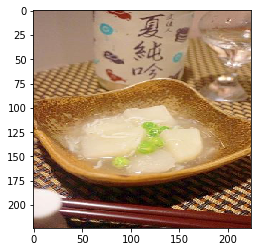

img 61: ['塩', 'みりん', '玉ねぎ', 'だしの素', '日本酒', '白子', '昆布', '梅干し', '河豚', '湯葉']


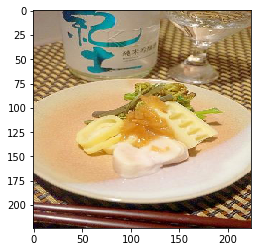

img 62: ['塩', '砂糖', 'ニンニク', 'ねぎ', '黒胡椒', '玉ねぎ', '酢', 'キュウリ', 'こしょう', 'エビ', '鶏ガラスープの素', 'レタス', 'ソース', 'ザーサイ']


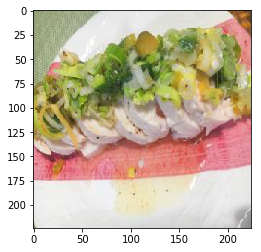

img 63: ['醤油', '砂糖', 'ニンニク', 'みりん', '生姜', 'ねぎ', '塩コショウ', '黒胡椒', 'サラダ油', '片栗粉', '豚肉', '豆板醤']


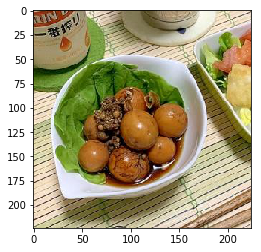

img 64: ['醤油', '塩', '生姜', 'マヨネーズ', '大根']


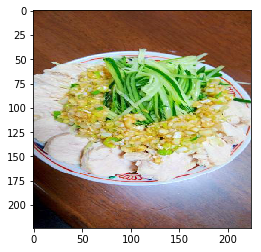

img 65: ['塩', '砂糖', 'ニンニク', 'パセリ', '鷹の爪', 'ガーリック', '鱈子']


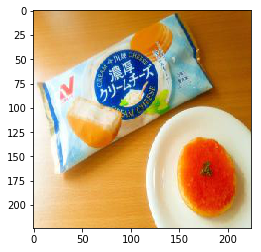

img 66: ['醤油', '塩', '砂糖', 'みりん', '塩コショウ', 'だしの素', '大根', '小麦粉', '大葉', 'ハム', '数の子']


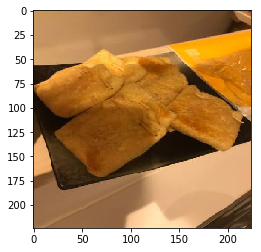

img 67: ['醤油', '塩', 'だしの素', '粒マスタード', '小松菜']


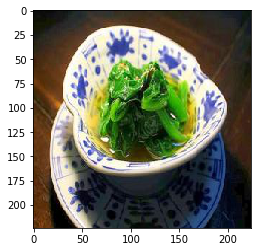

img 68: ['塩', 'ニンニク', '黒胡椒', '玉ねぎ', '酢', '日本酒', 'キュウリ', 'にんじん', '白ワイン', 'パスタ', '菜種油', '鰯', 'セロリ']


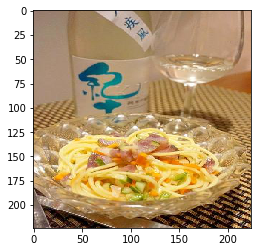

img 69: ['塩', '玉ねぎ', '片栗粉', '日本酒', 'キュウリ', 'ご飯', '白子', 'アボカド', '小松菜', 'たけのこ']


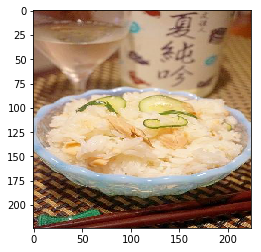

img 70: ['醤油', '塩', 'ニンニク', 'オリーブオイル', '片栗粉', 'ソース', 'ジェノベーゼソース']


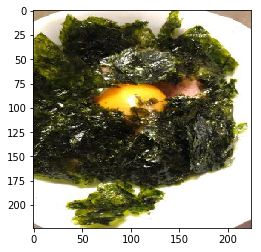

img 71: ['塩', 'ねぎ', 'オリーブオイル', '黒胡椒', 'マヨネーズ', 'クリームチーズ', '鯵', 'スモークサーモン']


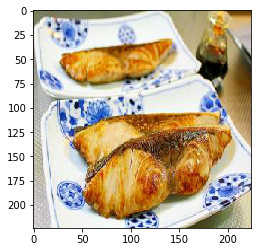

img 72: ['塩', '刺身', 'ムツ']


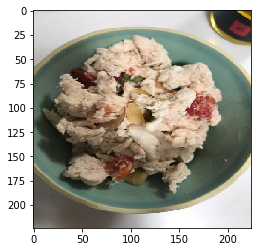

img 73: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒', 'トマト', '月桂樹', 'ジェノベーゼソース']


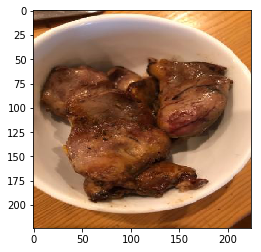

img 74: ['塩', '塩コショウ', 'キュウリ', '大葉', 'エビ', 'わかめ']


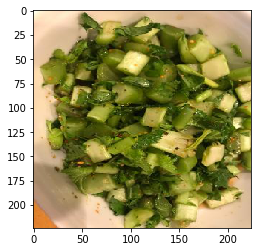

img 75: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒', '鶏肉', '小麦粉', 'エビ', 'マッシュルーム']


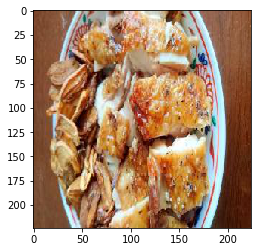

img 76: ['醤油', '砂糖', 'ゴマ油', 'みりん', 'ねぎ', '塩コショウ', '黒胡椒', 'じゃがいも', '豚肉', '鶏ガラスープの素', 'もやし']


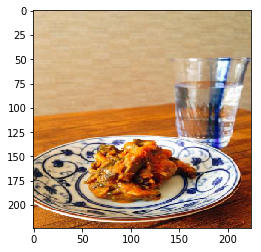

img 77: ['塩', 'ニンニク', '生姜', 'ねぎ', 'キュウリ', 'こしょう', '大根', 'パセリ', '梅干し']


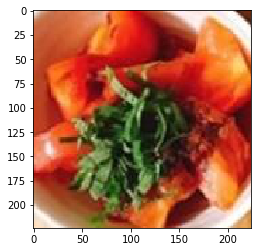

img 78: ['醤油', '塩', 'ゴマ油', '黒胡椒', 'だしの素', '片栗粉', '日本酒', 'ご飯', '粉チーズ', 'たけのこ']


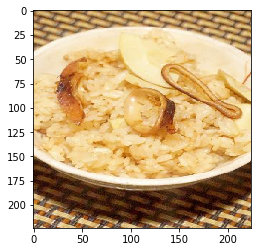

img 79: ['醤油', '塩', 'ニンニク', '黒胡椒', '卵', '片栗粉', '白ワイン', '粉チーズ', 'ブロッコリー', '菜種油', '柚子', '菜の花', 'たけのこ']


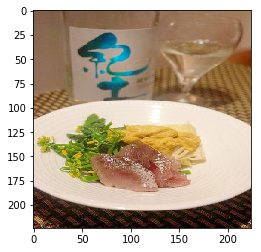

img 80: ['醤油', 'ゴマ油', '生姜', 'ねぎ', 'オリーブオイル', 'サラダ油', 'ナス', 'ブロッコリー', '海苔', 'しそ']


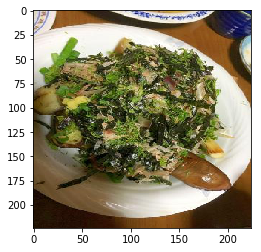

img 81: ['塩', 'オリーブオイル', 'キュウリ', '鷹の爪', '枝豆', 'ミツカン', '数の子']


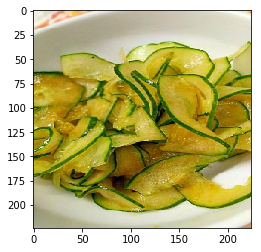

img 82: ['塩', 'みりん', '酢', 'バター', '味噌', 'キュウリ', 'ご飯', '柚子']


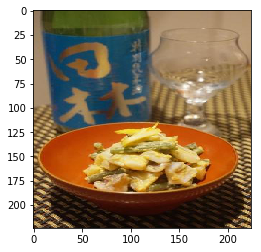

img 83: ['醤油', '塩', 'ゴマ油', '生姜', '日本酒', '鰹節', '鰯']


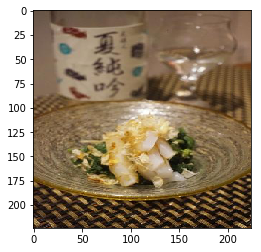

img 84: ['麺つゆ', '油揚げ', 'アボカド']


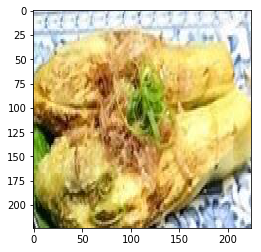

img 85: ['醤油', '塩', '生姜', 'ねぎ', '片栗粉', '味噌', '大葉', '鯵']


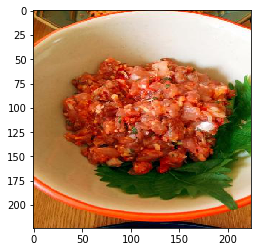

img 86: ['醤油', '塩', '生姜', 'オリーブオイル', '刺身', 'ムツ', 'せり']


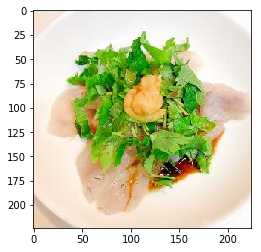

img 87: ['醤油', '生姜', '大葉', '刺身', 'パセリ', 'せり', 'イナダ', '鰆', '刺し身']


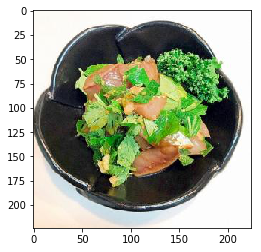

img 88: ['醤油', '塩', 'チーズ', '大根', 'イカ', '鮭', 'パクチー', '刺し身']


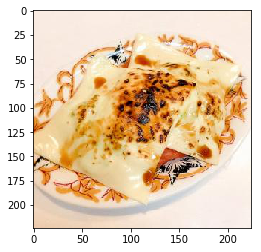

img 89: ['醤油', '塩', '七味唐辛子', 'こんにゃく']


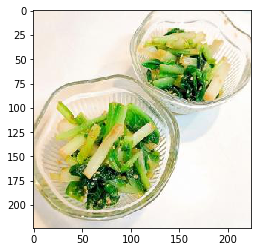

img 90: ['醤油', '砂糖', 'ゴマ油', 'みりん', '生姜', '卵']


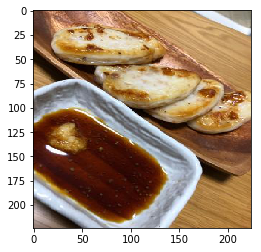

img 91: ['塩', '玉ねぎ', '片栗粉', '日本酒', '味噌', 'にんじん', '白ワイン', 'ご飯', '月桂樹', 'セロリ']


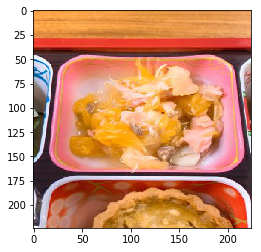

img 92: ['塩', '黒胡椒', '玉ねぎ', '卵', 'バター', '日本酒', 'にんじん', 'はちみつ', '豆乳', 'バゲット', 'さつまいも', 'りんご', 'サワークリーム']


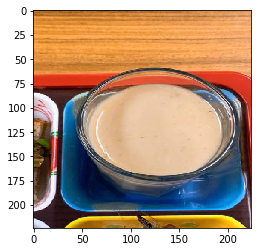

img 93: ['醤油', '塩', 'ねぎ', '塩コショウ', 'だしの素', 'こしょう', '鶏肉', 'しめじ', '鮭', '砂肝', 'えのき', 'もやし']


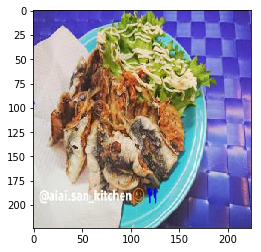

img 94: ['醤油', '塩', '砂糖', 'ニンニク', '生姜', '塩コショウ', '卵', 'マヨネーズ', 'サラダ油', '片栗粉', 'こしょう', '鶏肉', '豚肉', 'パン粉', '粒マスタード']


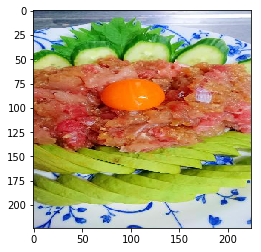

img 95: ['醤油', '塩', 'みりん', '生姜', 'トマト', '鷹の爪', '紹興酒']


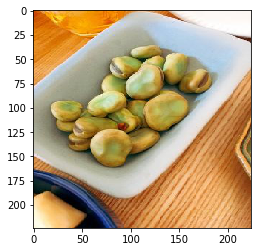

img 96: ['ニンニク', '塩コショウ', '卵', 'マヨネーズ', 'サラダ油', '片栗粉', '揚げ油', 'じゃがいも', '小麦粉', 'パン粉', '鰯']


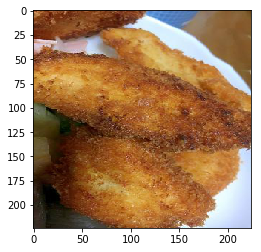

img 97: ['醤油', '塩コショウ', '玉ねぎ', 'だしの素', '片栗粉', '酢', '揚げ油', '麺つゆ', '胸肉', 'ミツカン', 'メンマ']


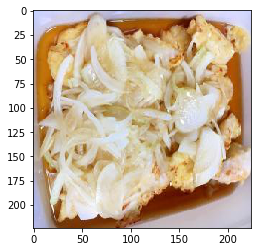

img 98: ['ニンニク', 'ゴマ油', '塩コショウ', '片栗粉', 'キュウリ', 'ゴマ', '揚げ油', '天ぷら粉', '胸肉', 'ミツカン']


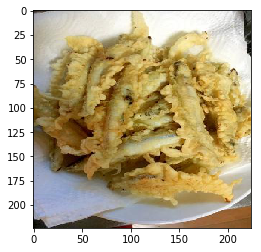

img 99: ['醤油', '塩', 'ニンニク', '塩コショウ', '玉ねぎ', 'トマト', 'パプリカ', 'アサリ', 'アスパラガス']


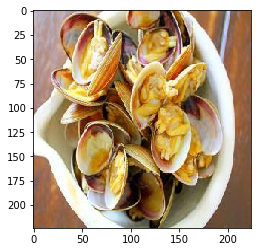

img 100: ['醤油', '砂糖', 'みりん', 'ねぎ', '酢', '鷹の爪']


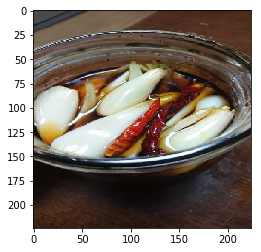

img 101: ['砂糖', 'みりん', '生姜', 'だしの素', '小麦粉', '竹輪', '天ぷら粉']


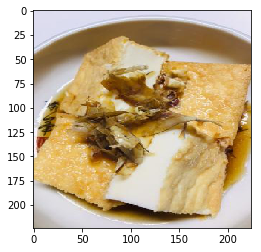

img 102: ['醤油', '塩', '砂糖', '生姜', 'オリーブオイル', 'だしの素', 'バター', '大根', 'にんじん', '豆腐', '昆布', 'ほうれん草', '赤唐辛子', 'アサリ', '小ねぎ', 'アスパラガス']


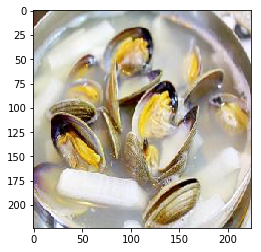

img 103: ['塩', '塩コショウ', '黒胡椒', '卵', 'チーズ']


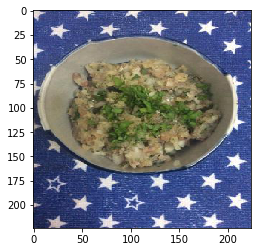

img 104: ['醤油', 'オリーブオイル', '黒胡椒', 'マヨネーズ', '片栗粉', '酢', 'キュウリ', 'じゃがいも', 'クリームチーズ', 'レタス']


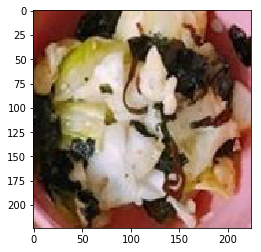

img 105: ['オリーブオイル', 'チーズ', 'トマト', 'パセリ', 'クリームチーズ', 'スモークサーモン']


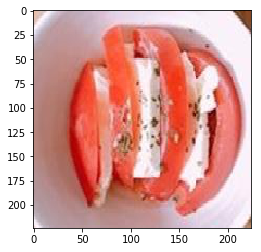

img 106: ['醤油', '塩', 'ねぎ', '卵', '片栗粉', 'しめじ', 'マグロ', '海苔', '白菜']


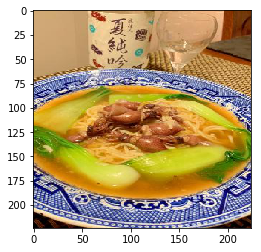

img 107: ['塩', '黒胡椒', 'レモン', 'せり', 'チリソース']


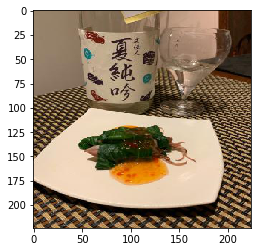

img 108: ['醤油', 'ねぎ', '塩コショウ', '玉ねぎ', 'チーズ', '麺つゆ']


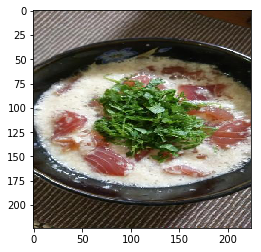

img 109: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'マヨネーズ', 'エビ', 'アボカド']


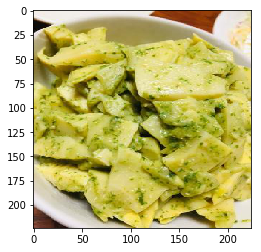

img 110: ['醤油', 'ゴマ油', 'オリーブオイル', 'ゴマ', 'トマト', 'カイワレ', '納豆']


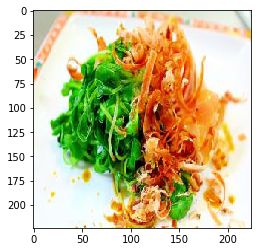

img 111: ['醤油', '砂糖', 'みりん', '味噌', '大根', 'ミックスナッツ']


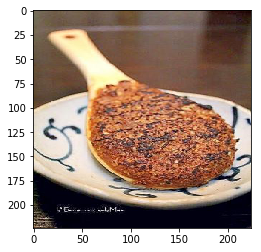

img 112: ['醤油', '塩', 'ニンニク', 'ゴマ油', 'オリーブオイル', '酢', 'キュウリ', 'トマト', '刺身', '鷹の爪', 'エビ', '鶏ガラスープの素', 'ブロッコリー']


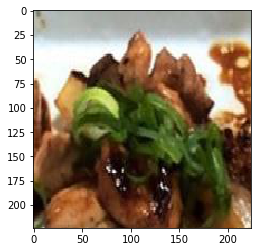

img 113: ['醤油', '塩', '砂糖', 'ゴマ油', '酢', 'キュウリ', 'こしょう', 'ゴマ', 'トマト', 'わさび', '鷹の爪', '塩昆布']


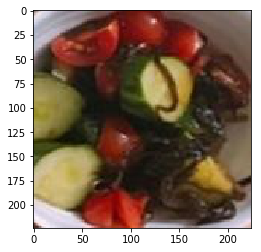

img 114: ['醤油', '塩', '砂糖', 'ゴマ油', 'みりん', '玉ねぎ', 'だしの素', 'サラダ油', 'にんじん', 'じゃがいも', 'イカ']


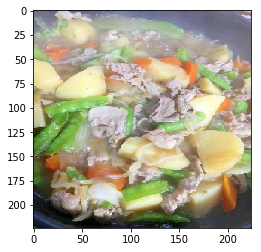

img 115: ['醤油', '塩', '砂糖', '酢', 'チーズ', 'レモン', 'キュウリ', '麺つゆ', 'オリーブ油', '刺身', '白ワイン', '豆板醤', 'ほうれん草', '鰹']


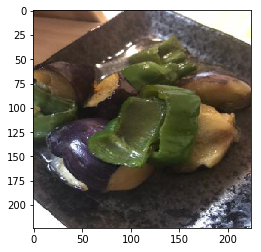

img 116: ['醤油', '塩', 'サラダ油', 'バター']


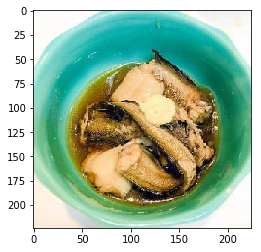

img 117: ['醤油', '塩', '砂糖', 'ニンニク', 'ゴマ油', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'だしの素', '片栗粉', '酢', 'レモン', 'キュウリ', 'こしょう', 'にんじん', 'トマト', 'パセリ', '鷹の爪', 'エビ', '牡蠣', 'パプリカ', 'セロリ']


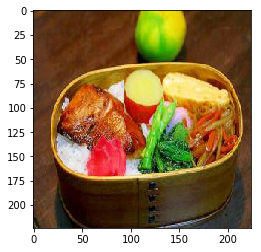

img 118: ['醤油', '砂糖', 'ゴマ油', '玉ねぎ', '卵', '鰹節', '豚肉', 'キャベツ', 'こんにゃく', 'えのき', '青海苔', '味の素']


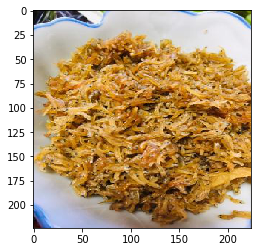

img 119: ['醤油', '塩', '砂糖', 'ニンニク', 'ゴマ油', 'オリーブオイル', '酢', 'バター', '味噌', 'キュウリ', '麺つゆ']


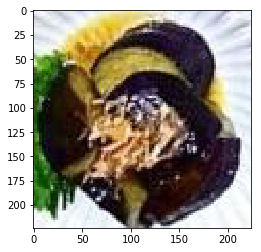

img 120: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '玉ねぎ', 'マヨネーズ', 'だしの素', 'サラダ油', '片栗粉', '鶏肉', 'じゃがいも', 'エビ', 'しめじ', 'ケチャップ', '焼肉のたれ', 'カレー粉']


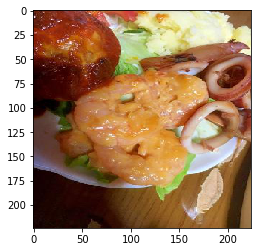

img 121: ['醤油', '砂糖', 'ニンニク', 'みりん', '生姜', 'ねぎ', '玉ねぎ', 'だしの素', 'サラダ油', '片栗粉', '酢', '大根', 'イカ', 'しめじ']


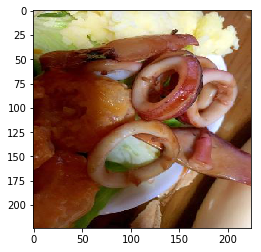

img 122: ['醤油', '塩', '砂糖', '生姜', 'ねぎ', '味噌', 'にんじん', '麺つゆ', '豆腐', '七味唐辛子', '厚揚げ', '鯖']


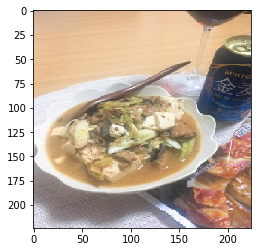

img 123: ['醤油', '砂糖', 'みりん', '日本酒']


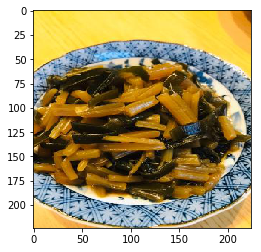

img 124: ['醤油', '塩', 'みりん', '酢', 'レモン', '大根']


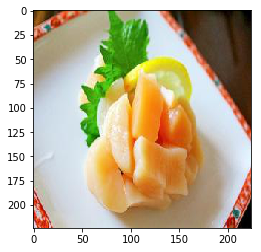

img 125: ['醤油', '塩', '砂糖', 'ニンニク', 'ゴマ油', 'みりん', '生姜', '塩コショウ', '玉ねぎ', 'だしの素', '酢', 'こしょう', 'にんじん', 'キャベツ', 'もやし']


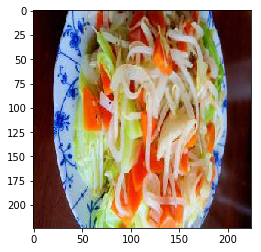

img 126: ['醤油', '塩', 'ニンニク', '塩コショウ', '片栗粉', 'こしょう', '鶏肉', '揚げ油']


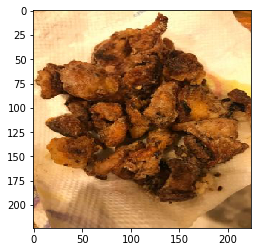

img 127: ['醤油', '塩', '砂糖', 'ニンニク', 'オリーブオイル', '黒胡椒', '酢', 'キュウリ', 'こしょう', 'トマト', '赤唐辛子']


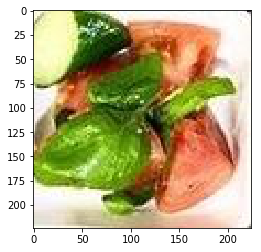

img 128: ['醤油', '塩', '砂糖', 'ゴマ油', '卵', 'だしの素', '酢', 'こしょう', '大根', '竹輪', 'こんにゃく']


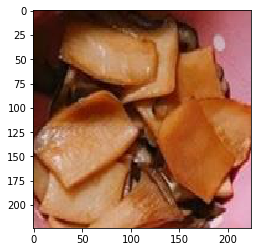

img 129: ['塩', '塩コショウ', 'だしの素', 'キャベツ', '鶏むね肉', '柚子']


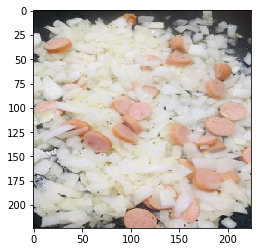

img 130: ['醤油', '塩', '砂糖', 'みりん', '黒胡椒', '味噌', '鶏肉', '揚げ油']


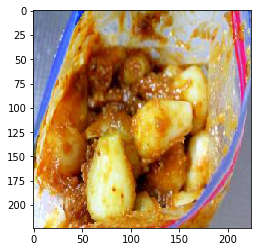

img 131: ['醤油', '塩', 'ニンニク', 'ゴマ油', 'だしの素', 'ポン酢', '赤唐辛子']


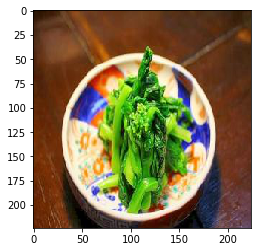

img 132: ['塩', 'オリーブオイル', 'だしの素', '日本酒', 'こしょう', '豆腐', '生ハム', 'ツナ', '河豚']


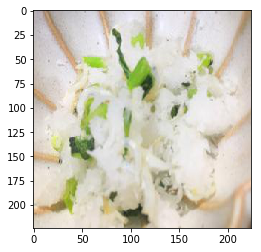

img 133: ['塩', 'ゴマ油', 'ねぎ', 'レモン', '海苔', '粒マスタード', '青じそ', '鶏皮', '鯖', '梅酢', '鰹のたたき']


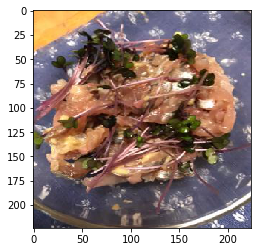

img 134: ['醤油', '塩', '砂糖', 'ゴマ油', '酢', '大根', 'にんじん', '麺つゆ', '鷹の爪', '茗荷', 'メンマ']


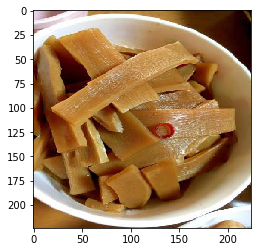

img 135: ['醤油', '塩', '砂糖', 'ニンニク', '生姜', 'ねぎ', '玉ねぎ', '大根', '辛子']


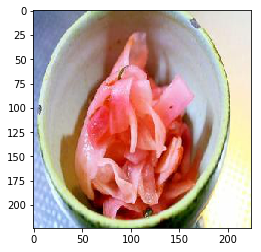

img 136: ['塩', '生姜', 'ねぎ', '大根', '麺つゆ']


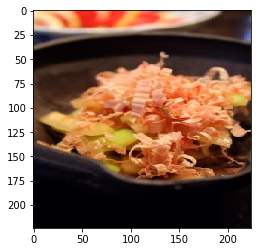

img 137: ['醤油', '塩', '砂糖', 'みりん', 'だしの素', 'トマト', '鰹節', '枝豆']


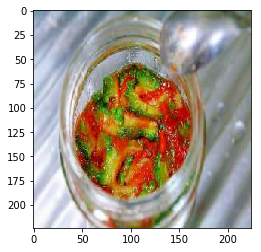

img 138: ['醤油', '砂糖', 'みりん', 'ねぎ', 'だしの素', 'サラダ油', '片栗粉', '酢', 'にんじん', '大葉', 'えのき', 'カレイ']


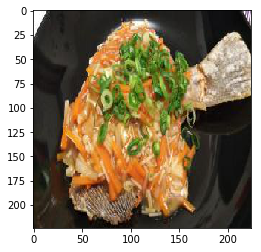

img 139: ['塩', 'ニンニク', 'ゴマ油', 'ねぎ', '塩コショウ', 'オリーブオイル', '鷹の爪', 'エリンギ', '焼肉のたれ', 'メンマ']


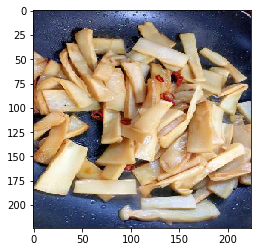

img 140: ['醤油', '砂糖', 'ゴマ油', 'みりん', 'だしの素', '片栗粉', '酢', '日本酒', '大根', '料理酒']


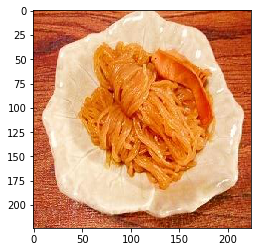

img 141: ['塩', 'じゃがいも', '落花生']


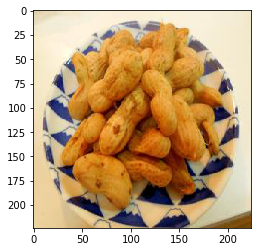

img 142: ['みりん', '卵', 'にんじん', '麺つゆ', '鰹節', 'イカ', '鮭', 'セロリ']


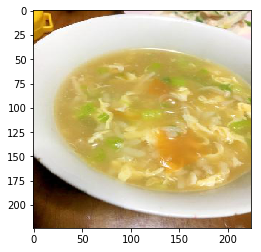

img 143: ['醤油', '砂糖', '生姜', '酢', 'キュウリ', 'マグロ']


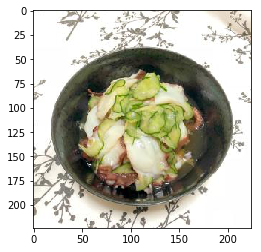

img 144: ['醤油', '砂糖', 'ニンニク', 'ゴマ油', 'ねぎ', '黒胡椒', '玉ねぎ', '味噌', '大葉', 'わさび', 'マグロ', '小松菜']


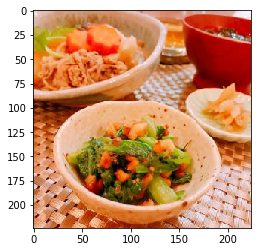

img 145: ['チーズ', 'トマト', 'シイタケ', 'マッシュルーム', 'バゲット', '塩辛']


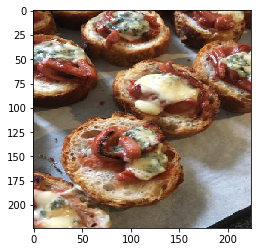

img 146: ['醤油', '塩', '玉ねぎ', '片栗粉', 'レモン', 'わさび', '刺身', '鷹の爪', 'クリームチーズ', 'アボカド', '白菜', '小松菜', 'いくら']


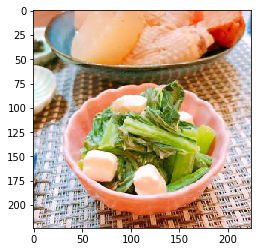

img 147: ['塩', 'ニンニク', 'オリーブオイル', 'マヨネーズ', '酢', '小麦粉', '七味唐辛子', 'レンコン', '明太子']


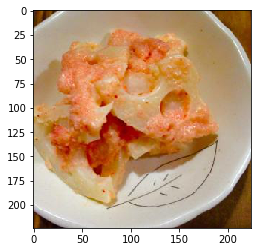

img 148: ['醤油', '砂糖', 'みりん', '生姜', '塩コショウ', 'サラダ油', '片栗粉', 'バター', '大根', 'イカ', '豆板醤']


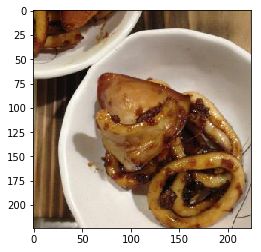

img 149: ['醤油', '塩', 'ニンニク', '塩コショウ', '玉ねぎ', 'サラダ油', '酢', 'バター', 'パセリ', 'イカ', '牡蠣']


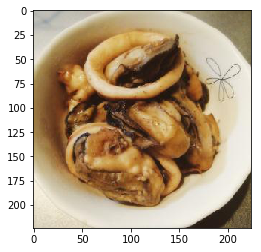

img 150: ['塩', 'とろけるチーズ', 'パセリ', 'レンコン', '唐辛子']


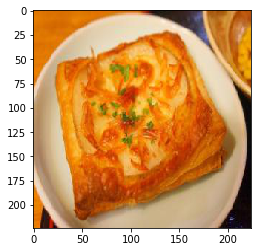

img 151: ['塩', 'オリーブオイル', 'バター', 'コンソメ', '落花生']


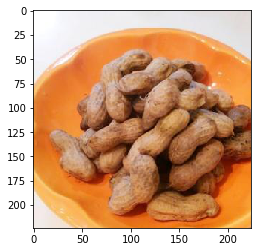

img 152: ['醤油', 'ねぎ', 'チーズ']


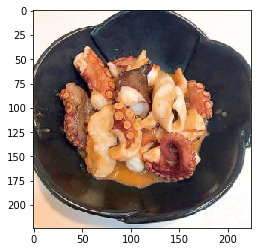

img 153: ['醤油', '塩', 'ニンニク', '生姜', '玉ねぎ', '卵', 'レモン', '小麦粉', '鷹の爪', 'パン粉', 'タコ', '水菜']


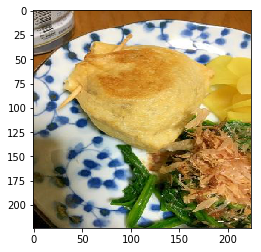

img 154: ['塩', '砂糖', 'ニンニク', '黒胡椒', 'マヨネーズ', 'チーズ', 'バター', 'じゃがいも', 'とろけるチーズ', 'オリーブ油', 'ベーコン', 'ケチャップ', '牛乳', 'バジル', 'かぼちゃ', '食パン', 'りんご']


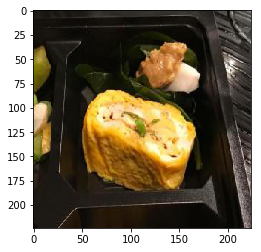

img 155: ['醤油', '塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'マヨネーズ', 'だしの素', '酢', 'キュウリ', 'じゃがいも', '豆腐', '豚肉', '白菜']


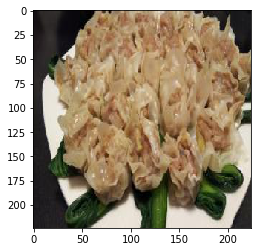

img 156: ['醤油', '塩', '砂糖', '生姜', 'ねぎ', 'だしの素', '日本酒', '味噌', '小松菜', '里芋']


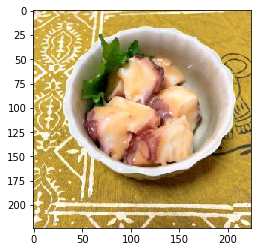

img 157: ['醤油', '塩', '酢', 'バター', '日本酒', '大根', 'ポン酢', 'わさび', 'しめじ', '昆布', '柚子', '河豚']


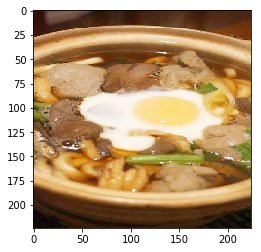

img 158: ['醤油', '塩', 'みりん', '生姜', 'ねぎ', '片栗粉', '日本酒', '大根', 'にんじん', 'キャベツ', 'シイタケ', 'こんにゃく', '菜の花']


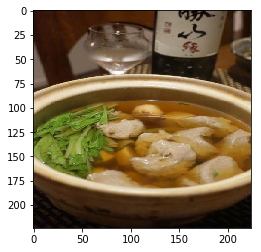

img 159: ['醤油', '塩', '砂糖', 'ゴマ油', 'チーズ', '鰹節', '油揚げ', '白菜']


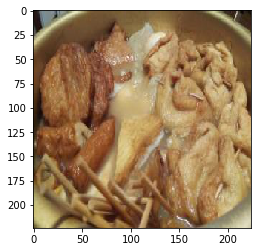

img 160: ['醤油', '塩', '砂糖', 'みりん', '生姜', 'わさび', 'イカ', '白ごま', '鯵']


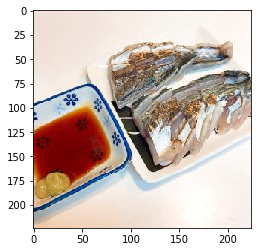

img 161: ['塩', '黒胡椒', '片栗粉', '白ワイン', 'ラー油', '粒マスタード', 'エリンギ', '菜種油', '豆乳', '柚子', '菜の花', 'せり']


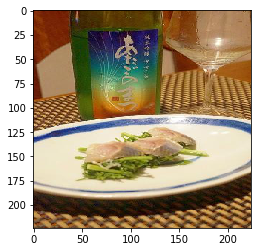

img 162: ['醤油', '塩', 'ニンニク', 'みりん', '生姜', 'オリーブオイル', '黒胡椒', '味噌', 'ごぼう', 'カレイ']


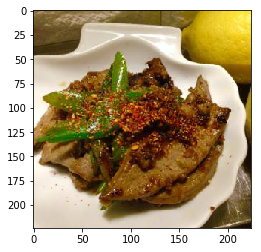

img 163: ['醤油', '砂糖', 'ニンニク', 'ゴマ油', '片栗粉', '揚げ油', 'じゃがいも', '小麦粉']


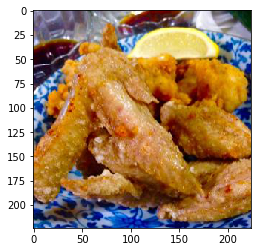

img 164: ['醤油', '塩', '黒胡椒', 'マヨネーズ', 'だしの素', '日本酒', '大根', '豆腐', 'なんこつ']


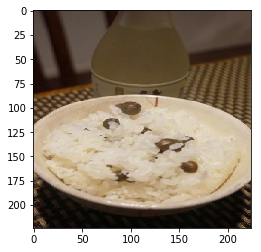

img 165: ['醤油', '塩', 'ゴマ油', 'みりん', '生姜', 'ねぎ', '黒胡椒', '片栗粉', '日本酒', 'にんじん', 'キャベツ', 'オイスターソース']


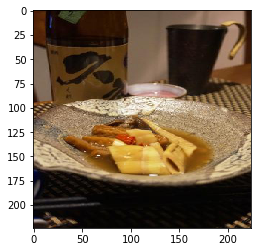

img 166: ['醤油', '塩', '砂糖', '生姜', '酢', 'わさび', 'イカ']


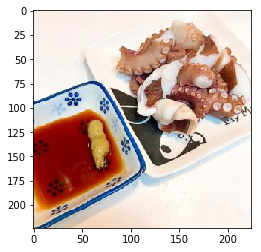

img 167: ['醤油', '塩', '生姜', '酢', 'バター', 'わさび']


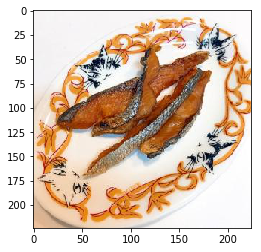

img 168: ['醤油', '塩', '砂糖', 'みりん', '酢', 'チーズ', 'バター', '日本酒', '味噌', 'キャベツ', 'ほうれん草']


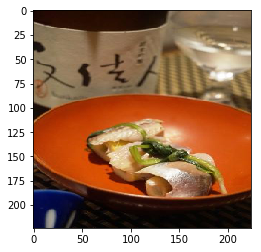

img 169: ['醤油', '塩', 'ニンニク', 'ゴマ油', '生姜', '塩コショウ', 'オリーブオイル', '黒胡椒', '片栗粉', '鶏肉', '豆腐', 'カイワレ']


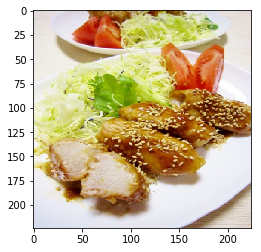

img 170: ['醤油', '塩', '砂糖', 'ニンニク', 'みりん', '塩コショウ', 'マヨネーズ', 'オリーブ油', 'エビ', 'ケチャップ', 'ブロッコリー', '粒マスタード', '薄力粉']


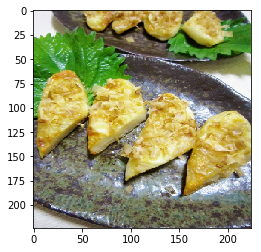

img 171: ['醤油', '塩', '砂糖', 'ニンニク', 'ゴマ油', 'みりん', 'ねぎ', 'だしの素', 'ほうれん草']


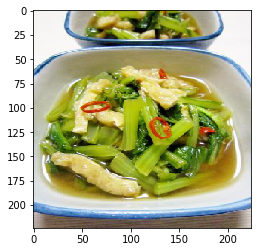

img 172: ['醤油', 'みりん', '生姜', 'ねぎ', '鰹節', '一味唐辛子', 'マグロ']


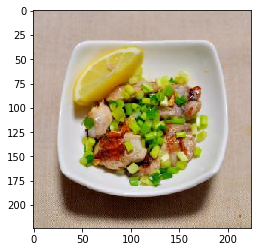

img 173: ['醤油', '塩', '砂糖', '生姜', '酢', 'ソース']


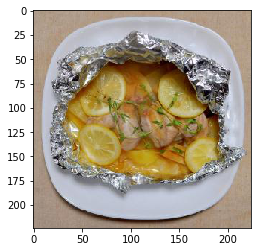

img 174: ['醤油', '塩', 'みりん', '生姜', 'ねぎ', '味噌', '大根', '鰹節', '刺身', '一味唐辛子', '茗荷']


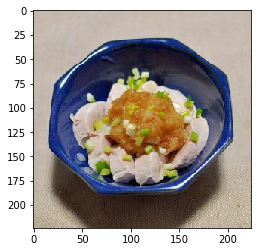

img 175: ['醤油', '塩', '砂糖', '生姜', '鶏肉', '七味唐辛子', 'こんにゃく']


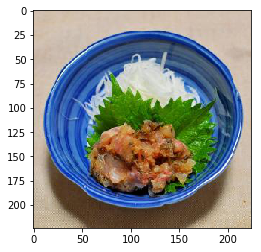

img 176: ['塩', '黒胡椒', '卵', 'マヨネーズ', '片栗粉', 'キュウリ', '鶏肉', '揚げ油', '麺つゆ', 'じゃがいも', 'ツナ']


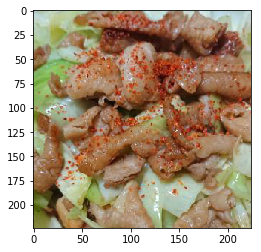

img 177: ['塩', '砂糖', 'みりん', '生姜', '卵', 'だしの素', 'サラダ油', '麺つゆ', '竹輪']


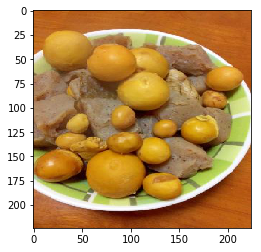

img 178: ['醤油', '塩', '砂糖', 'ニンニク', '生姜', 'だしの素', '片栗粉', '大根', '鶏肉', '揚げ油', 'こんにゃく']


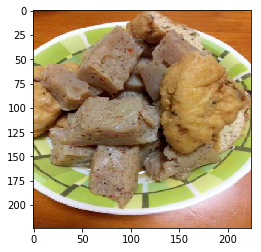

img 179: ['塩', '塩コショウ', '揚げ油', '落花生']


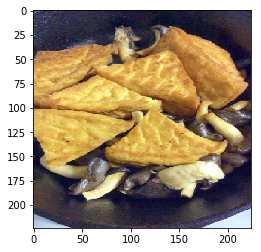

img 180: ['塩', '酢', 'レモン', '味噌', 'ゴマ', 'ポン酢', '鰹のたたき', 'スプラウト']


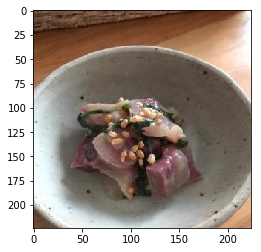

img 181: ['醤油', '塩', 'ねぎ', 'ゴマ', 'オリーブ油', 'ごぼう', 'カニカマ']


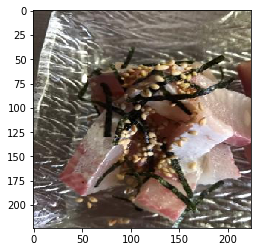

img 182: ['塩', 'オリーブオイル', '卵', 'マヨネーズ', '酢', 'こしょう', '揚げ油', '小麦粉', 'ベーコン', 'コンソメ', '枝豆']


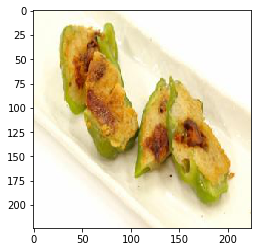

img 183: ['醤油', '塩', 'みりん', '塩コショウ', 'オリーブオイル', '黒胡椒', 'チーズ', '日本酒', 'トマト', 'パセリ', '白ワイン', 'ご飯', 'パスタ']


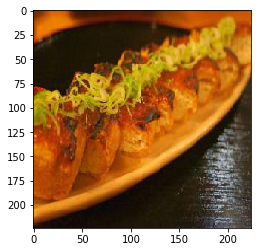

img 184: ['醤油', '砂糖', '生姜', '鶏肉', '麺つゆ']


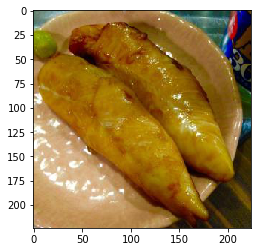

img 185: ['塩', 'ニンニク', 'ねぎ', '塩コショウ', 'オリーブオイル', 'チーズ', '魚肉ソーセージ']


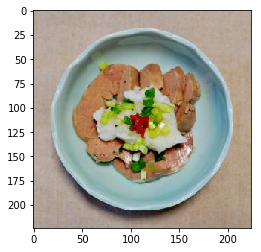

img 186: ['塩', 'ねぎ', '黒胡椒', 'バター', '日本酒', '河豚', '鱈']


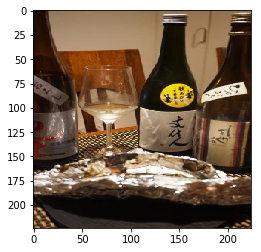

img 187: ['醤油', '塩', 'ねぎ', '日本酒', '大根', 'ポン酢', 'しめじ', '白菜']


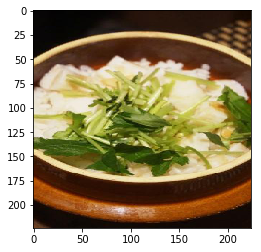

img 188: ['醤油', '塩', 'ゴマ油', '生姜', 'ねぎ', '黒胡椒', 'だしの素', '日本酒', '菜の花']


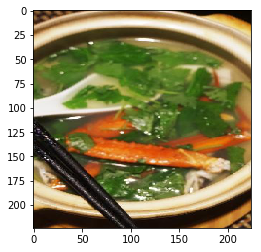

img 189: ['塩', 'ニンニク', 'ゴマ油', '塩コショウ', '黒胡椒', '玉ねぎ', 'にんじん', 'ケチャップ', 'ウスターソース']


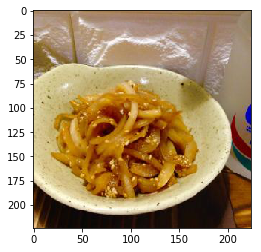

img 190: ['塩', 'サラダ油', '片栗粉', 'こしょう', 'じゃがいも']


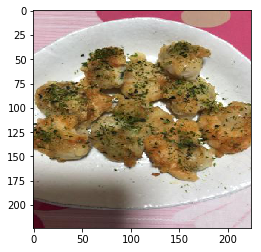

img 191: ['醤油', '塩', 'みりん', '卵', '日本酒', '大根', 'はちみつ', '山椒', '赤ワイン']


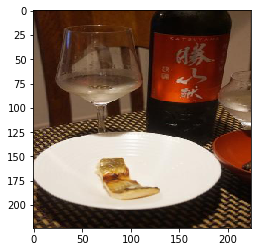

img 192: ['塩', '塩コショウ', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'チーズ', 'レモン', 'トマト', 'ベーコン', 'エビ', 'ケチャップ', 'ナス', 'アボカド', 'コンソメ', 'バジル', 'ウインナー', '豆乳', 'ローズマリー']


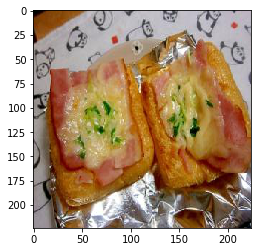

img 193: ['醤油', '砂糖', 'みりん', '生姜', 'ねぎ', '玉ねぎ', 'イカ', 'コチュジャン', '塩辛']


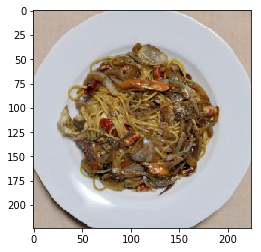

img 194: ['醤油', '塩', '生姜', 'バター', '鷹の爪', '茗荷']


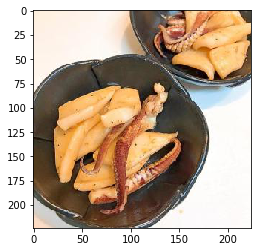

img 195: ['醤油', '塩', '生姜', 'イカ', '昆布', 'カイワレ']


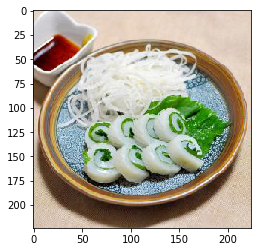

img 196: ['醤油', '塩', 'ゴマ油', '生姜', '卵', '鶏肉', '豆板醤']


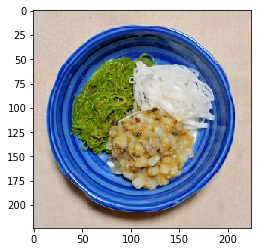

img 197: ['醤油', '塩', '砂糖', 'ゴマ油', '黒胡椒', 'バター', '鰹節', 'ピーマン', 'マグロ', 'ししとう']


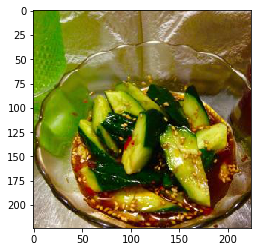

img 198: ['チーズ']


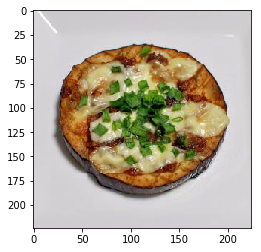

img 199: ['醤油', '塩', '砂糖', 'みりん', '生姜', 'オリーブオイル', '黒胡椒']


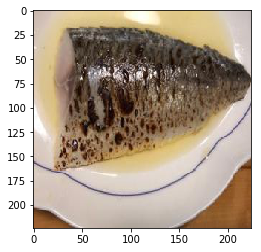

img 200: ['醤油', '塩']


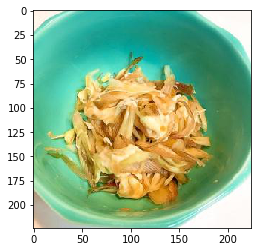

img 201: ['醤油', '塩', '砂糖', 'みりん', '卵', 'だしの素', 'サラダ油', '片栗粉', '大根', '鶏肉', 'はちみつ', '酒粕']


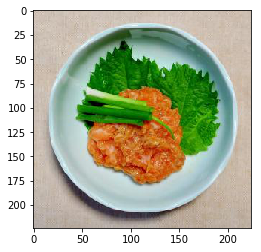

img 202: ['塩', 'オリーブオイル', '揚げ油', 'ごぼう', '落花生', '三温糖']


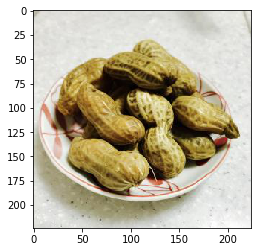

img 203: ['醤油', '塩', '生姜', 'ねぎ', '日本酒', '大根', 'にんじん', 'しめじ', 'シイタケ', 'ご飯', '白菜']


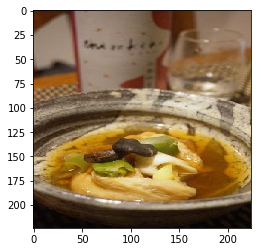

img 204: ['醤油', '塩', '塩コショウ', '玉ねぎ', '卵', 'バター', '味噌', '大根', 'はちみつ', '海苔', '月桂樹', '赤ワイン']


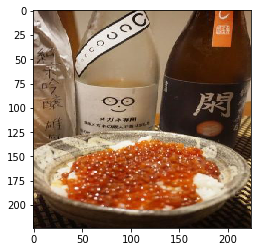

img 205: ['塩', 'ニンニク', 'ゴマ油', '生姜', 'ねぎ', '玉ねぎ', '酢', '味噌', '麺つゆ', 'ポン酢', '豆腐', '七味唐辛子', '一味唐辛子', '鯖']


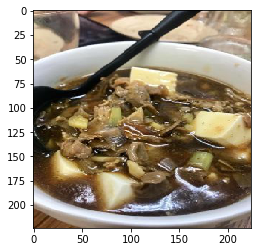

img 206: ['塩', 'オリーブオイル', '玉ねぎ', '卵', 'サラダ油', 'チーズ', '一味唐辛子', '青海苔']


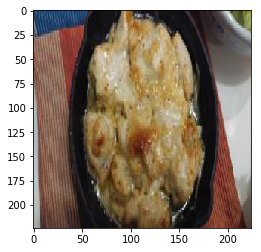

img 207: ['醤油', '塩', 'ニンニク', 'ゴマ油', '生姜', '塩コショウ', '酢', 'バター', '餃子の皮', '料理酒']


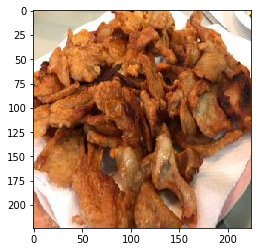

img 208: ['醤油', '塩', '砂糖', 'みりん', '生姜', '黒胡椒', 'サラダ油', '片栗粉', '日本酒', '白ごま', 'ごぼう']


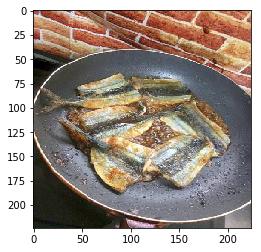

img 209: ['醤油', '塩', '生姜', 'ねぎ', '玉ねぎ', '大葉', '刺身', 'ムツ', 'ナンプラー']


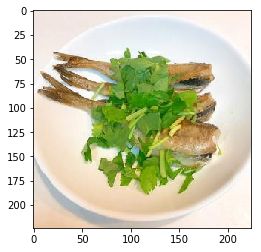

img 210: ['醤油', '塩', '生姜', 'マヨネーズ', 'にんじん', '刺身']


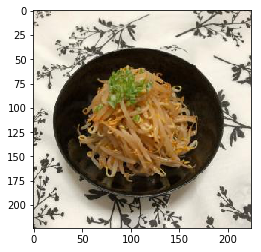

img 211: ['醤油', '塩', '生姜', '大根', '大葉', '刺身', 'マグロ']


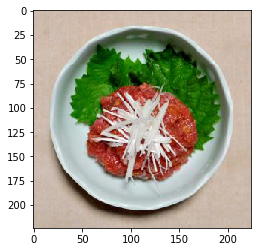

img 212: ['醤油', '塩', '砂糖', 'ゴマ油', '生姜', 'だしの素', '酢', '長芋', '里芋']


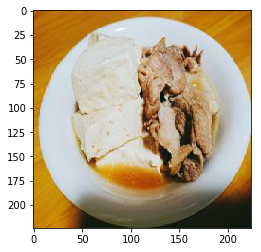

img 213: ['醤油', '塩', '砂糖', 'ニンニク', 'ゴマ油', '味噌', 'えのき', '唐辛子', 'コチュジャン']


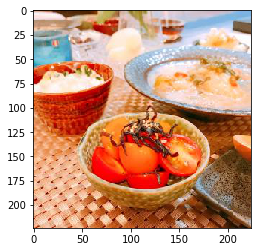

img 214: ['塩', 'ニンニク', 'ねぎ', 'オリーブオイル', '大根', '刺身', '砂肝', 'ほうれん草', '小ねぎ', '唐揚げ粉']


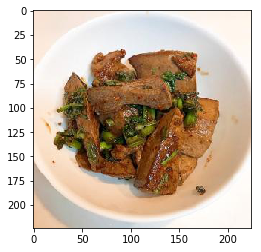

img 215: ['塩', 'ねぎ', 'バター', 'パセリ']


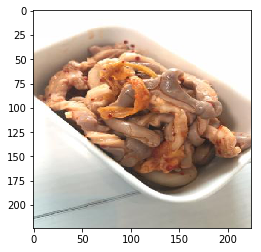

img 216: ['塩', 'ねぎ', 'レモン', 'ポン酢', '辛子']


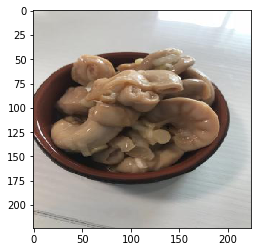

img 217: ['醤油', 'みりん', '生姜', 'カイワレ']


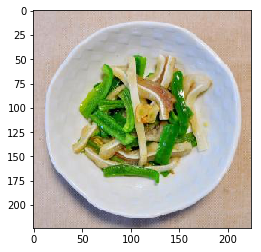

img 218: ['醤油', '塩', '砂糖', '塩コショウ', 'オリーブオイル', '黒胡椒', '小麦粉', '大葉', '油揚げ', 'パン粉', '鯛']


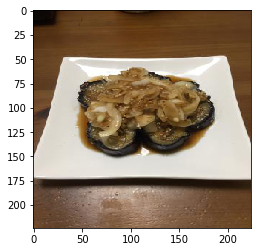

img 219: ['塩', '砂糖', '塩コショウ', '卵', '片栗粉', '揚げ油', '小麦粉', '豚肉', '三温糖']


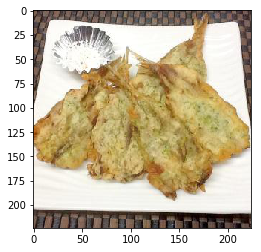

img 220: ['醤油', '塩', 'みりん', '生姜', 'サラダ油']


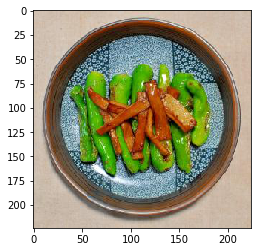

img 221: ['醤油', '塩', '砂糖', 'みりん', '七味唐辛子', 'いくら']


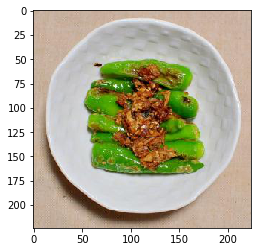

img 222: ['醤油', 'ニンニク', 'みりん', '生姜', '塩コショウ', 'マヨネーズ', '味噌', '小麦粉', '豚肉', '酒粕']


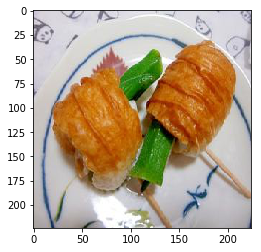

img 223: ['醤油', '砂糖', 'みりん', 'サラダ油', '大根', 'ゴマ', 'ごぼう']


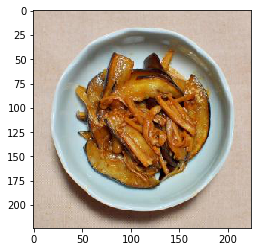

img 224: ['醤油', '砂糖', 'みりん', 'だしの素', '三温糖', '粗目']


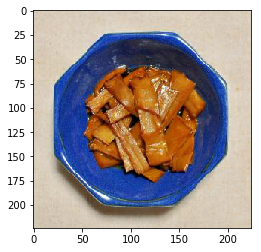

img 225: ['醤油', '塩', '砂糖', 'ゴマ油', 'ねぎ', '麺つゆ', '鰹節']


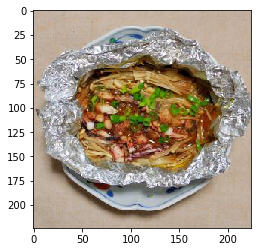

img 226: ['醤油', '塩', '砂糖', 'みりん', 'オリーブオイル', '鰹節', '柚子こしょう', 'えんどう豆']


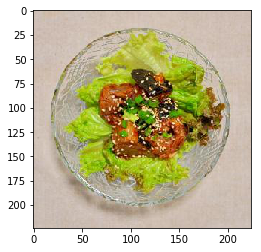

img 227: ['醤油', '塩', 'サラダ油']


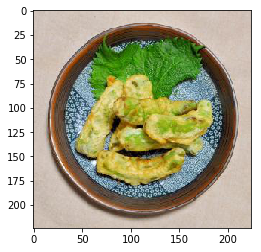

img 228: ['醤油', '塩', '砂糖', 'みりん', '日本酒', 'レモン', '味噌', '麺つゆ', 'わさび']


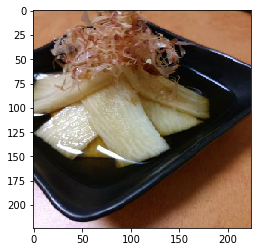

img 229: ['塩', '砂糖', 'ニンニク', 'みりん', '塩コショウ', 'オリーブオイル', '玉ねぎ', 'バター', 'こしょう', 'はちみつ', '赤ワイン', '牛肉']


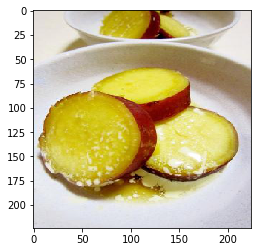

img 230: ['醤油', '塩', 'ニンニク', 'ねぎ', '玉ねぎ', 'サラダ油', '酢', 'バター', 'こしょう', '一味唐辛子', 'カレー粉']


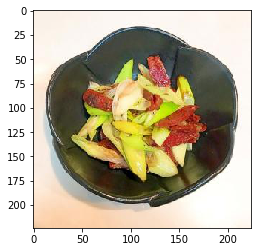

img 231: ['醤油', '塩', 'みりん', '生姜', 'オリーブオイル', '酢', '大根', 'わさび']


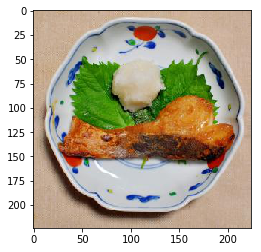

img 232: ['醤油', '砂糖', 'みりん', '卵', 'サラダ油', '味噌']


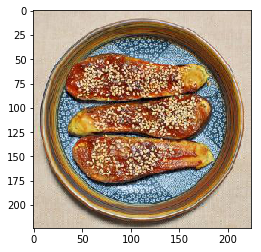

img 233: ['醤油', '塩', '砂糖', 'みりん', '生姜', '塩コショウ', 'だしの素', '酢', '大根', '揚げ油', '小麦粉', '鷹の爪', '料理酒', 'クラッカー', '粗目']


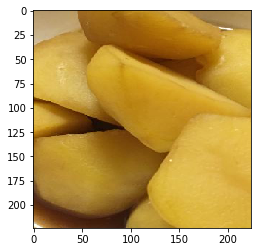

img 234: ['塩', '砂糖', 'ニンニク', 'オリーブオイル', '玉ねぎ', 'こしょう', 'トマト', 'マジックソルト', 'ジェノベーゼソース', 'ドライパセリ']


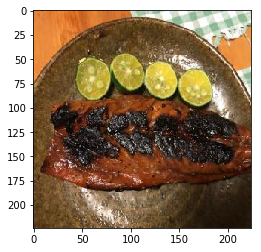

img 235: ['醤油', '塩', '砂糖', 'みりん', 'わさび', '酒粕', 'セロリ']


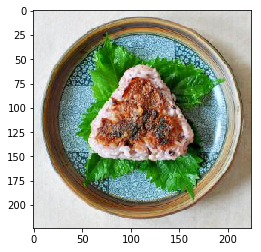

img 236: ['塩', '砂糖', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒', 'バター', '鶏肉', 'ポン酢', '刺身', '白ワイン', 'タコ', '菜の花']


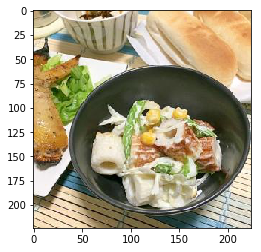

img 237: ['塩', 'オリーブオイル', '玉ねぎ', 'マヨネーズ', '味噌', '揚げ油', 'じゃがいも', '豆腐', 'シイタケ', 'パスタ', '天ぷら粉', 'ハーブソルト']


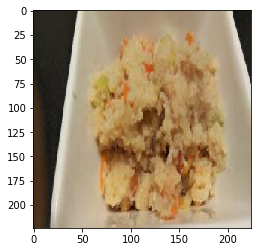

img 238: ['醤油', '塩', 'みりん', '酢', '日本酒', '麺つゆ', 'ほうれん草', '水菜']


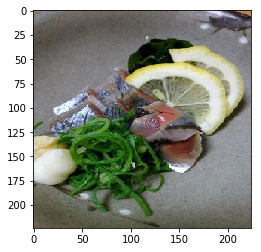

img 239: ['醤油', '塩', 'ゴマ油', 'ゴマ', '鰹節', 'ラー油']


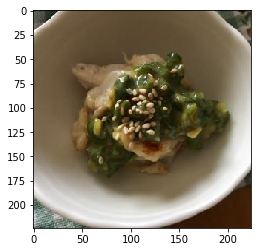

img 240: ['醤油', '生姜', 'ねぎ', '塩コショウ', 'サラダ油', 'わさび', '茗荷']


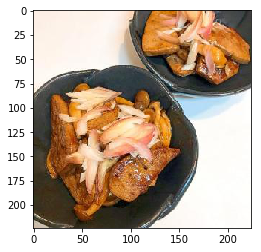

img 241: ['塩', 'ニンニク', 'ねぎ', '塩コショウ', 'オリーブオイル', '黒胡椒', '片栗粉', '大葉', '白ワイン', 'ガーリックパウダー']


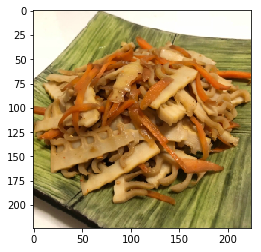

img 242: ['醤油', '砂糖', 'ゴマ油', 'みりん', '生姜', 'ゴマ', '麺つゆ', '海苔', 'ラー油', 'ザーサイ']


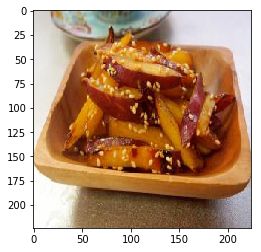

img 243: ['醤油', '塩', '生姜', '大根', '刺身', 'カイワレ', '鯖']


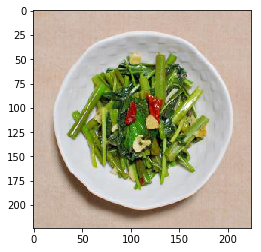

img 244: ['醤油', 'バター', '麺つゆ', '豆苗']


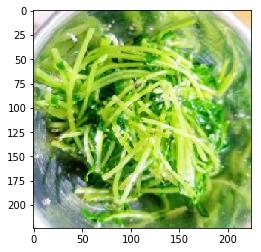

img 245: ['醤油', 'ゴマ油', 'みりん', '麺つゆ', '鰹節', '塩昆布']


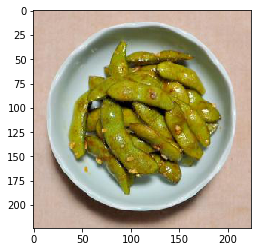

img 246: ['塩', '日本酒', '大根', '鰹節', '刺身', '白子', 'レタス', 'ムツ', 'せり', 'チリソース', 'いくら']


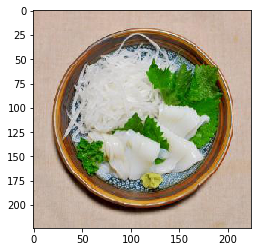

img 247: ['醤油', '塩', 'みりん', 'カレー粉']


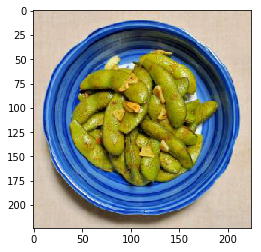

img 248: ['醤油', '砂糖', 'オリーブオイル', 'チーズ', '麺つゆ', 'パセリ']


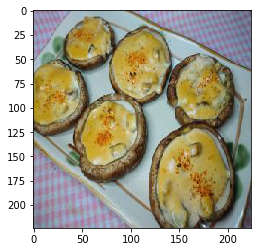

img 249: ['塩', 'マヨネーズ', 'チーズ', 'バター', '味噌', '揚げ油', '小麦粉', '豚肉', '牛乳', '餃子の皮', '薄力粉', '酒粕', '強力粉', 'インスタントドライイースト']


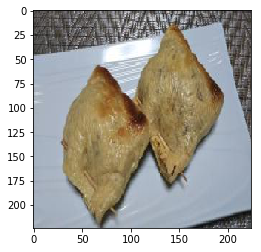

img 250: ['醤油', '塩', 'みりん', '酢', '落花生']


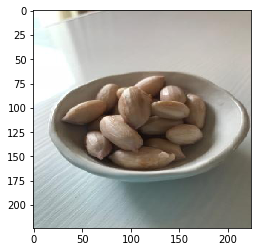

img 251: ['醤油', '塩', 'みりん', '酢']


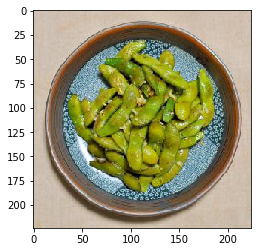

img 252: ['醤油', 'ニンニク', 'ゴマ油', 'みりん', 'ねぎ', 'チーズ', '鰹節', 'こんにゃく', '厚揚げ', 'ソース']


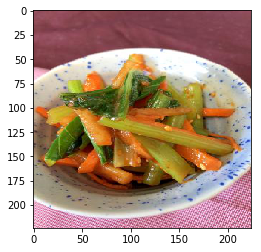

img 253: ['醤油', '砂糖', 'ニンニク', '塩コショウ', '卵', 'サラダ油', '酢', 'チーズ', '豚肉', 'クレイジーソルト']


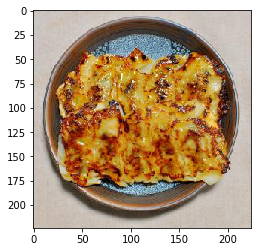

img 254: ['醤油', '塩', 'オリーブオイル', '刺身', 'せり']


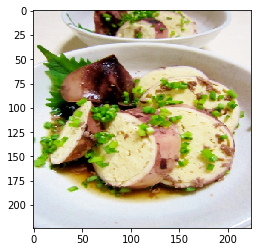

img 255: ['醤油', '砂糖', 'みりん', '玉ねぎ', '卵', 'だしの素', '大根']


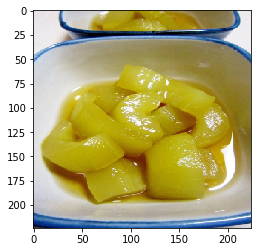

img 256: ['醤油', '塩', '砂糖', 'ねぎ', '塩コショウ', 'バター', '豆板醤']


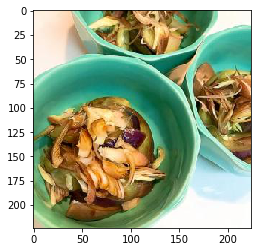

img 257: ['醤油', '塩', '塩コショウ', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'マヨネーズ', '大根', 'にんじん', '小麦粉', '白ワイン', 'ケチャップ', 'クリームチーズ', '昆布', 'ソース', 'バケット', '三温糖', 'ナツメグ']


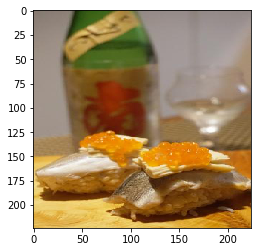

img 258: ['醤油', '塩', '砂糖', 'ニンニク', '生姜', '塩コショウ', 'サラダ油', '豆板醤', 'ししとう']


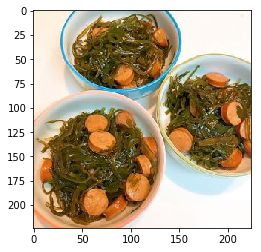

img 259: ['塩', 'ゴマ油', '生姜', '黒胡椒', '日本酒', 'キュウリ', '山椒', '菜種油', '鰯']


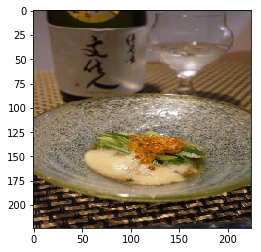

img 260: ['ニンニク', '塩コショウ', '黒胡椒', '卵', 'マヨネーズ', 'サラダ油', 'キュウリ', 'じゃがいも', '豚肉', 'カレー粉']


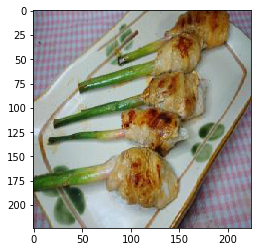

img 261: ['塩', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'チーズ', 'バター', 'とろけるチーズ', 'ケチャップ', '餃子の皮', 'ハム', 'バジル', '枝豆', 'クレイジーソルト', 'コーン']


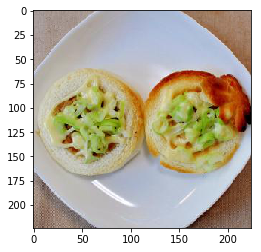

img 262: ['塩', '黒胡椒', '日本酒', 'しめじ', 'パスタ', 'もやし']


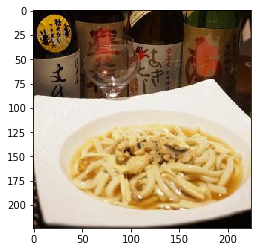

img 263: ['塩', 'ニンニク', 'みりん', 'ねぎ', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'こしょう', 'とろけるチーズ', '月桂樹', 'セロリ']


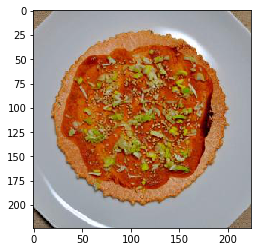

img 264: ['塩', 'ゴマ油', '生姜', '黒胡椒', '卵', '酢', '日本酒', 'レモン', '山椒', '鱧']


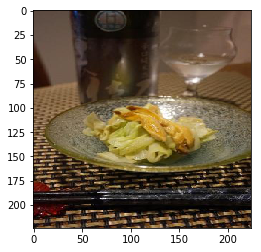

img 265: ['醤油', '塩', '生姜', '酢', '刺身', '鯖', '鰆']


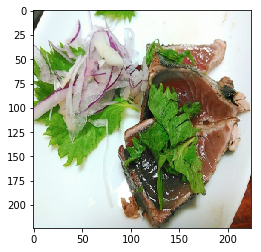

img 266: ['醤油', '塩', 'ニンニク', '生姜', 'ねぎ', '塩コショウ', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'バター', 'こしょう', '小麦粉', '白ワイン', 'タコ', 'コンソメ', 'マッシュルーム', 'ナツメグ']


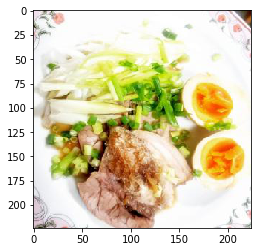

img 267: ['塩', '卵', '日本酒', 'はちみつ', 'エリンギ', '鱧']


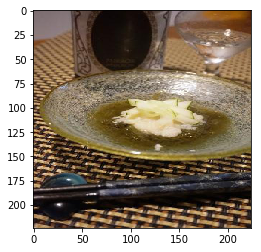

img 268: ['塩', '砂糖', 'ニンニク', 'ゴマ油', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'にんじん', '鷹の爪', '月桂樹', 'トマトソース']


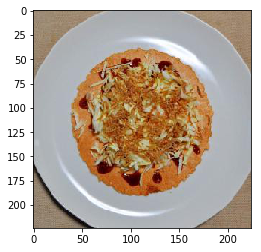

img 269: ['塩', '黒胡椒', '大根']


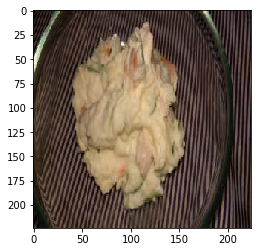

img 270: ['醤油', '塩', 'みりん', '黒胡椒', '卵', 'クリームチーズ', 'いくら']


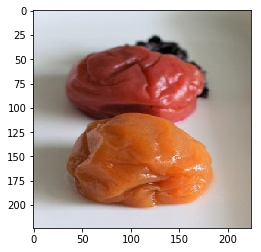

img 271: ['醤油', '砂糖', 'みりん', '生姜', 'ねぎ', 'ゴマ', '刺し身']


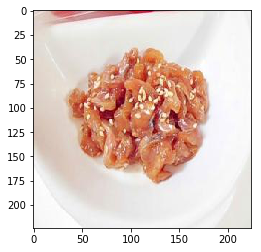

img 272: ['醤油', '塩', '砂糖', '生姜', 'マヨネーズ', '鶏肉', 'わさび', '鰹節', 'ラー油', '山芋']


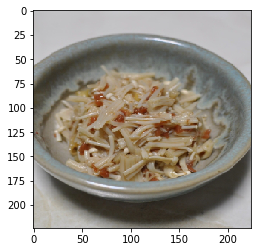

img 273: ['醤油', '砂糖', 'ニンニク', '生姜', 'ねぎ', '玉ねぎ', 'だしの素', '味噌', '豆腐', '豚肉', '一味唐辛子', '餃子の皮']


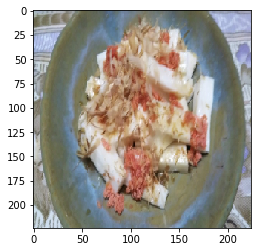

img 274: ['醤油', '塩', '砂糖', 'ニンニク', 'みりん', '玉ねぎ']


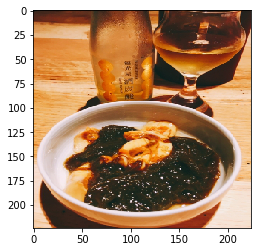

img 275: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒', 'ウインナー', '味の素', 'マーガリン']


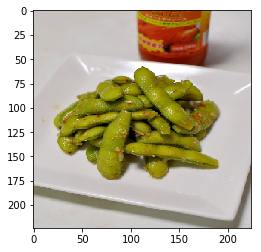

img 276: ['醤油', '塩', 'ゴマ油', 'だしの素', '大根', 'にんじん', '鶏肉', 'ゴマ', 'ポン酢', '鰹節', '白ごま', '海苔', '梅干し', '水菜', 'パプリカ', '納豆', '梅', 'ドレッシング']


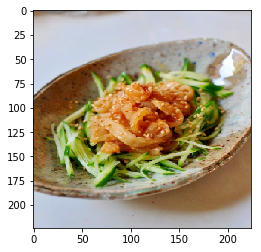

img 277: ['醤油', '砂糖', 'ゴマ油', 'みりん', '生姜', 'ねぎ', 'だしの素', '鶏ガラスープの素', '鮭']


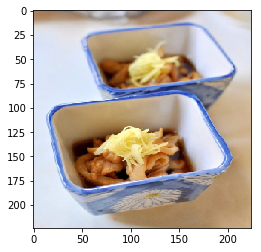

img 278: ['塩', 'ニンニク', '塩コショウ', '玉ねぎ', '酢', 'バター', '白ワイン', 'しめじ', '粒マスタード', '生クリーム', 'つぶ貝']


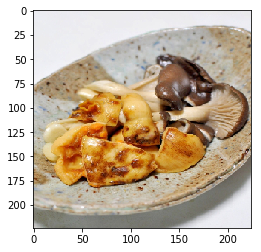

img 279: ['醤油', '塩', 'ニンニク', 'ゴマ油', 'キュウリ', '豆板醤']


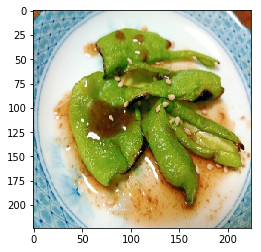

img 280: ['醤油', 'ニンニク', '生姜', 'ねぎ', '片栗粉', '大根']


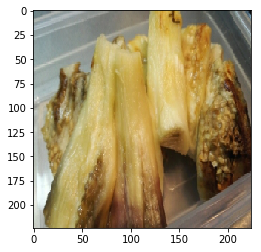

img 281: ['醤油', '塩', '砂糖', 'みりん', '生姜', 'サラダ油', '酢', '大根', 'にんじん']


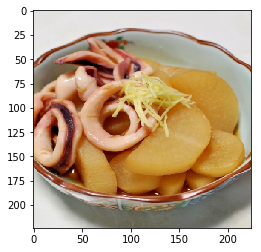

img 282: ['塩', '砂糖', 'ニンニク', 'みりん', '塩コショウ', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'レモン', '揚げ油', '小麦粉', '刺身', 'エビ', '白ワイン', '粉チーズ', '牛乳', 'ブロッコリー', 'コンソメ', '唐辛子', 'ガーリックパウダー', '生クリーム', 'しそ', 'ナツメグ']


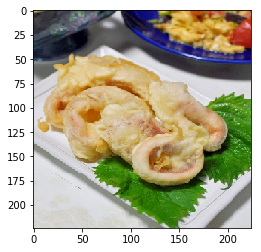

img 283: ['塩', 'オリーブオイル', 'マヨネーズ', 'チーズ', 'じゃがいも', '牛乳', 'かぼちゃ', 'サワークリーム']


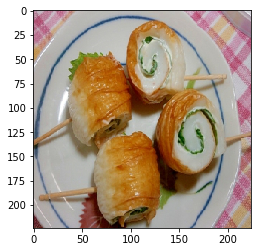

img 284: ['塩', 'オリーブオイル', '黒胡椒', 'だしの素', 'バター', '牛乳', '餃子の皮', 'パスタ', 'はんぺん']


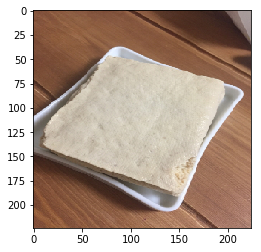

img 285: ['塩', 'ニンニク', 'ゴマ油', '黒胡椒', 'レモン', 'こしょう', 'ポン酢', '牡蠣', '砂肝', 'ラー油', 'ライム']


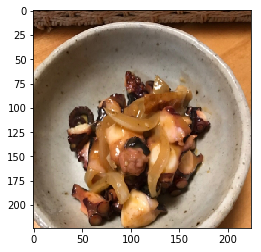

img 286: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒', 'マヨネーズ', '味噌', '牛乳', 'ブロッコリー', '薄力粉', 'ウインナー']


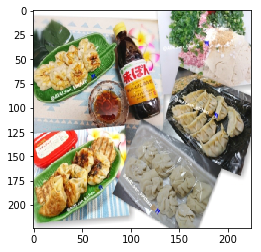

img 287: ['醤油', '塩', '砂糖', '塩コショウ', '卵', 'サラダ油', '片栗粉', '味噌', 'ゴマ', '豚肉', '塩麹']


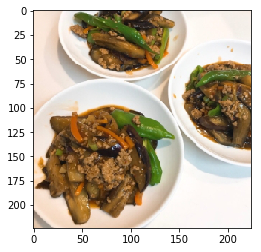

img 288: ['醤油', 'みりん', '黒胡椒', 'サラダ油', '片栗粉', '鯵']


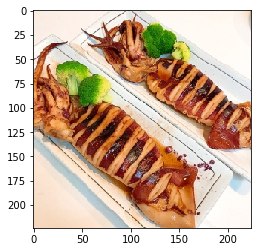

img 289: ['醤油', '塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '玉ねぎ', '片栗粉', '鶏肉', 'オイスターソース', 'メンマ']


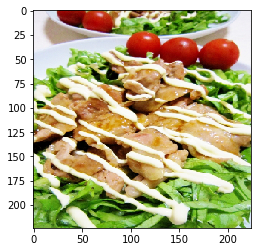

img 290: ['塩', 'オリーブオイル', '枝豆']


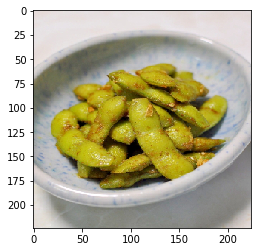

img 291: ['醤油', '砂糖', 'みりん', '片栗粉', 'ホタテ']


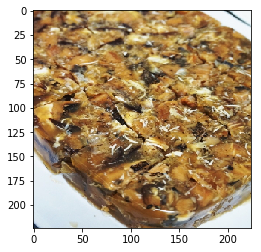

img 292: ['塩', 'みりん', 'オリーブオイル', '卵', 'チーズ', '大根', 'ベーコン', 'ご飯', '粉チーズ', 'ブロッコリー', '昆布', 'マジックソルト']


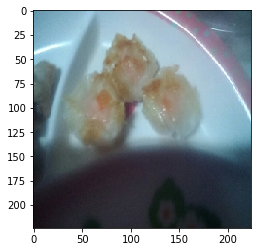

img 293: ['塩', '塩コショウ', '玉ねぎ', 'アサリ']


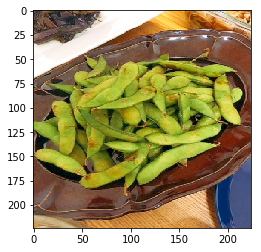

img 294: ['醤油', '塩', 'オリーブオイル', '大葉', '刺身', 'パクチー', 'ムツ', 'せり']


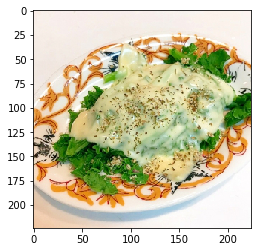

img 295: ['醤油', '塩', '生姜', 'マヨネーズ', 'だしの素', '酢', '大根', 'じゃがいも', '大葉', '豆腐', '青じそ', '梅酢']


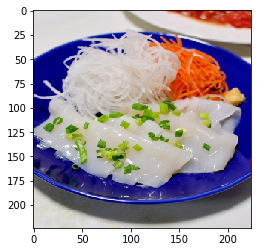

img 296: ['ニンニク', 'ねぎ', '塩コショウ', 'オリーブオイル', '黒胡椒', '卵', 'マヨネーズ', 'サラダ油', '小麦粉', '豆腐', 'シイタケ', 'パン粉']


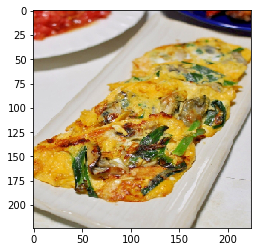

img 297: ['醤油', '塩', '黒胡椒', '砂肝']


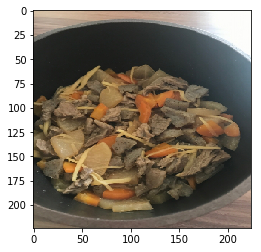

img 298: ['醤油', '塩', '砂糖', 'ゴマ油', 'みりん', 'ねぎ', 'だしの素', '大根', 'にんじん', '茗荷', '料理酒']


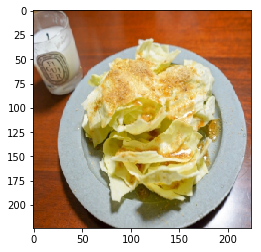

img 299: ['塩', '生姜', '黒胡椒', '日本酒', '味噌', 'こんにゃく', 'はちみつ', '粒マスタード', 'エリンギ']


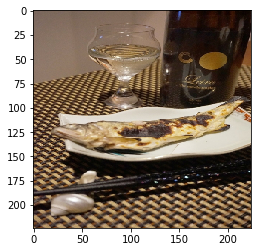

img 300: ['塩', '砂糖', 'ニンニク', '塩コショウ', 'オリーブオイル', 'キュウリ', '鶏肉', 'じゃがいも', 'ポン酢', 'キャベツ', 'セロリ']


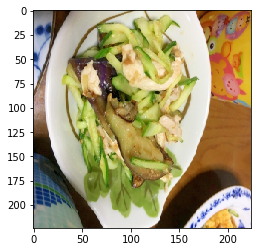

img 301: ['醤油', '塩', 'ニンニク', '生姜', 'オリーブオイル', '大葉', '刺身', 'パクチー', 'ムツ']


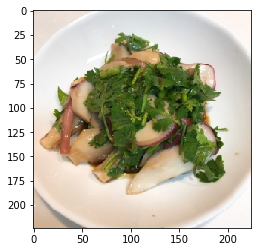

In [26]:
# test
preds = model.predict(x_test[400:])
th = 0.05
for i, (x, pred) in enumerate(zip(x_test[400:], preds)):
    indexes = np.where(pred > th)[0]
    words = [detokenizer[idx+1] for idx in indexes]
    print(f'img {i}: {words}')
    plt.imshow(x/255.0)
    plt.show()
    print(f'=========================================')
    if i > 300:
        break

In [ ]:
# vocab_size = len(tokenizer.word_index) + 1
# caption_len = len(y_train[0])

# K.clear_session()

# # VGG
# encoder_input = Input(shape=(224, 224, 3))
# encoder_input_normalized = Lambda(lambda x: x / 255.)(encoder_input) # [0, 255) -> [0, 1)
# encoder = VGG16(weights='imagenet', include_top=False, input_tensor=encoder_input_normalized)

# # パラメータを固定
# for layer in encoder.layers:
#     layer.trainable = False

# # CNNの出力
# u = Flatten()(encoder.output)

# vgg_model = Model(encoder_input, u)

# # VGGから特徴量を抽出
# x_train_features = []
# x_test_features = []

# for x in tqdm(x_train):
#     x_features = vgg_model.predict(x[np.newaxis]).flatten()
#     x_train_features.append(x_features)

# for x in tqdm(x_test):
#     x_features = vgg_model.predict(x[np.newaxis]).flatten()
#     x_test_features.append(x_features)

# x_train_features = np.stack(x_train_features, axis=0)
# x_test_features = np.stack(x_test_features, axis=0)

# # 特徴量を保存
# np.save('/root/userspace/private/lesson5/data/x_train_features', x_train_features)
# np.save('/root/userspace/private/lesson5/data/x_test_features', x_test_features)